# Implement STYLE-GAN on your own using PyTorch.

In [1]:
# import required libraries

import torch, torchvision
from torch import nn, optim
from torchvision import datasets, transforms
import torch.nn.functional as F
from torch.utils.data import DataLoader, Dataset
from torchvision.utils import save_image
from math import log2
import numpy as np
import os
from tqdm import tqdm
import matplotlib.pylab as plt
from torchmetrics.image.fid import FrechetInceptionDistance
import lpips
import csv
from lpips import LPIPS 
import torchvision.models as models
from PIL import Image
from torch.cuda.amp import autocast

In [4]:
# Hyperparameters

DATASET = 'STYLEGAN/train'
INITIAL_IMG_SIZE = 4
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
LR = 1e-3
BATCH_SIZES = [256,256,128,64,32,16]
CHANNELS_IMG = 3
Z_DIM = 512
W_DIM = 512
IN_CHANNELS = 512
LAMBDA_GP = 10
PROGRESSIVE_EPOCHS = [35] * len(BATCH_SIZES)

In [5]:
# Tracking losses
loss_gen_list = []
loss_critic_list = []

In [3]:
# get data loader

class FolderDataset(Dataset):
   def __init__(self, root, transform=None):
       self.root = root
       self.transform = transform
       self.image_paths = [os.path.join(root, img) for img in os.listdir(root)
                           if img.endswith(('.png', '.jpg', '.jpeg'))]


   def __len__(self):
       return len(self.image_paths)


   def __getitem__(self, idx):
       img_path = self.image_paths[idx]
       img = Image.open(img_path).convert("RGB")
       if self.transform:
           img = self.transform(img)
       return img, 0  

def get_loader(image_size):
   transform = transforms.Compose(
       [
           transforms.Resize((image_size, image_size)),
           transforms.ToTensor(),
           transforms.RandomHorizontalFlip(p=0.5),
           transforms.Normalize(
               [0.5 for _ in range(CHANNELS_IMG)],
               [0.5 for _ in range(CHANNELS_IMG)],
           ),
       ]
   )
   batch_size = BATCH_SIZES[int(log2(image_size / 4))]
   dataset = FolderDataset(root=DATASET, transform=transform)
   loader = DataLoader(dataset, batch_size=batch_size, shuffle=True)
   return loader, dataset



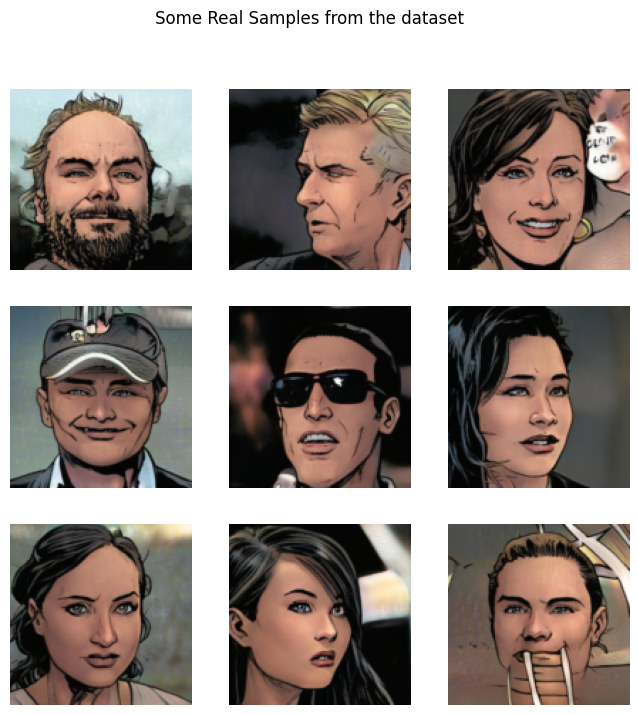

In [4]:
# check if data is loaded properly and print a few samples

def check_loader():
   loader, _ = get_loader(128)
   stylee, _ = next(iter(loader))
   _, ax = plt.subplots(3, 3, figsize=(8, 8))
   plt.suptitle('Some Real Samples from the dataset')
   ind = 0
   for k in range(3):
       for kk in range(3):
           ax[k][kk].imshow((stylee[ind].permute(1, 2, 0) + 1) / 2) 
           ax[k][kk].axis("off")
           ind += 1
   plt.show()

check_loader()


In [5]:
# factors contains the numbers that will multiply with IN_CHANNELS to have the number of channels required in each image resolution
factors = [1,1,1,1/2,1/4,1/8,1/16,1/32]

In [6]:
# Weighted Scaled Linear class - initialize linear layer and define forward 
class WSLinear(nn.Module):
    def __init__(
        self, in_features, out_features
    ):
        super(WSLinear,self).__init__()
        self.linear = nn.Linear(in_features, out_features)
        self.scale  = (2/in_features) ** 0.5
        self.bias   = self.linear.bias
        self.linear.bias = None

        nn.init.normal_(self.linear.weight)
        nn.init.zeros_(self.bias)

    def forward(self,x):
        return self.linear(x * self.scale) + self.bias

In [7]:
# normalizes Z before the Noise Mapping Network
class PixenNorm(nn.Module):
    def __init__(self):
        super(PixenNorm, self).__init__()
        self.epsilon = 1e-8
    def forward(self,x ):
        return x / torch.sqrt(torch.mean(x**2, dim=1, keepdim=True)+  self.epsilon)

In [8]:
# create Mapping Network class
class MappingNetwork(nn.Module):
    def __init__(self, z_dim, w_dim):
        super().__init__()
        self.mapping = nn.Sequential(
            PixenNorm(),
            WSLinear(z_dim, w_dim),
            nn.ReLU(),
            WSLinear(w_dim, w_dim),
            nn.ReLU(),
            WSLinear(w_dim, w_dim),
            nn.ReLU(),
            WSLinear(w_dim, w_dim),
            nn.ReLU(),
            WSLinear(w_dim, w_dim),
            nn.ReLU(),
            WSLinear(w_dim, w_dim),
            nn.ReLU(),
            WSLinear(w_dim, w_dim),
            nn.ReLU(),
            WSLinear(w_dim, w_dim),
        )
    
    def forward(self,x):
        return self.mapping(x)

In [9]:
# define the Adaptive Instance Normalization class
class AdaIN(nn.Module):
    def __init__(self, channels, w_dim):
        super().__init__()
        self.instance_norm = nn.InstanceNorm2d(channels)
        self.style_scale   = WSLinear(w_dim, channels)
        self.style_bias    = WSLinear(w_dim, channels)

    def forward(self,x,w):
        x = self.instance_norm(x)
        style_scale = self.style_scale(w).unsqueeze(2).unsqueeze(3)
        style_bias  = self.style_bias(w).unsqueeze(2).unsqueeze(3)
        return style_scale * x + style_bias

In [10]:
# this injects noise into the generator
class injectNoise(nn.Module):
    def __init__(self, channels):
        super().__init__()
        self.weight = nn.Parameter(torch.zeros(1,channels,1,1))

    def forward(self, x):
        noise = torch.randn((x.shape[0], 1, x.shape[2], x.shape[3]), device = x.device)
        return x + self.weight + noise

In [11]:
# In the generator class, we have a few repeating patterns which can be done by creating this class and using it in Generator class
class GenBlock(nn.Module):
    def __init__(self, in_channel, out_channel, w_dim):
        super(GenBlock, self).__init__()
        self.conv1 = WSConv2d(in_channel, out_channel)
        self.conv2 = WSConv2d(out_channel, out_channel)
        self.leaky = nn.LeakyReLU(0.2, inplace=True)
        self.inject_noise1 = injectNoise(out_channel)
        self.inject_noise2 = injectNoise(out_channel)
        self.adain1 = AdaIN(out_channel, w_dim)
        self.adain2 = AdaIN(out_channel, w_dim)
    def forward(self, x,w):
        x = self.adain1(self.leaky(self.inject_noise1(self.conv1(x))), w)
        x = self.adain2(self.leaky(self.inject_noise2(self.conv2(x))), w)
        return x

In [12]:
# Generator class
class Generator(nn.Module):
    def __init__(self, z_dim, w_dim, in_channels, img_channels=3):
        super().__init__()
        self.starting_cte = nn.Parameter(torch.ones(1, in_channels, 4,4))
        self.map = MappingNetwork(z_dim, w_dim)
        self.initial_adain1 = AdaIN(in_channels, w_dim)
        self.initial_adain2 = AdaIN(in_channels, w_dim)
        self.initial_noise1 = injectNoise(in_channels)
        self.initial_noise2 = injectNoise(in_channels)
        self.initial_conv   = nn.Conv2d(in_channels, in_channels, kernel_size=3, stride=1, padding=1)
        self.leaky          = nn.LeakyReLU(0.2, inplace=True)

        self.initial_rgb    = WSConv2d(
            in_channels, img_channels, kernel_size = 1, stride=1, padding=0
        )
        self.prog_blocks, self.rgb_layers = (
            nn.ModuleList([]),
            nn.ModuleList([self.initial_rgb])
        )

        for i in range(len(factors)-1):
            conv_in_c  = int(in_channels * factors[i])
            conv_out_c = int(in_channels * factors[i+1])
            self.prog_blocks.append(GenBlock(conv_in_c, conv_out_c, w_dim))
            self.rgb_layers.append(WSConv2d(conv_out_c, img_channels, kernel_size = 1, stride=1, padding=0))
        
    def fade_in(self, alpha, upscaled, generated):
        return torch.tanh(alpha * generated + (1-alpha ) * upscaled)

    def forward(self, noise, alpha, steps):
        w = self.map(noise)
        x = self.initial_adain1(self.initial_noise1(self.starting_cte),w)
        x = self.initial_conv(x)
        out = self.initial_adain2(self.leaky(self.initial_noise2(x)), w)

        if steps == 0:
            return self.initial_rgb(x)
        
        for step in range(steps):
            upscaled = F.interpolate(out, scale_factor=2, mode = 'bilinear')
            out      = self.prog_blocks[step](upscaled,w)

        final_upscaled = self.rgb_layers[steps-1](upscaled)
        final_out      = self.rgb_layers[steps](out)

        return self.fade_in(alpha, final_upscaled, final_out)

In [13]:
# Weighted Scaled Convolution layer is to Equalized Learning Rate for the conv layers
class WSConv2d(nn.Module):
    def __init__(
        self, in_channels, out_channels, kernel_size=3, stride=1, padding=1
    ):
        super(WSConv2d, self).__init__()
        self.conv = nn.Conv2d(in_channels, out_channels, kernel_size, stride, padding)
        self.scale = (2 / (in_channels * (kernel_size ** 2))) ** 0.5
        self.bias = self.conv.bias
        self.conv.bias = None

        # initialize conv layer
        nn.init.normal_(self.conv.weight)
        nn.init.zeros_(self.bias)

    def forward(self, x):
        return self.conv(x * self.scale) + self.bias.view(1, self.bias.shape[0], 1, 1)

In [14]:
# This class will help in creation of discriminator
class ConvBlock(nn.Module):
    def __init__(self, in_channels, out_channels):
        super(ConvBlock, self).__init__()
        self.conv1 = WSConv2d(in_channels, out_channels)
        self.conv2 = WSConv2d(out_channels, out_channels)
        self.leaky = nn.LeakyReLU(0.2)

    def forward(self, x):
        x = self.leaky(self.conv1(x))
        x = self.leaky(self.conv2(x))
        return x

In [15]:
# discriminator class
class Discriminator(nn.Module):
    def __init__(self, in_channels, img_channels=3):
        super(Discriminator, self).__init__()
        self.prog_blocks, self.rgb_layers = nn.ModuleList([]), nn.ModuleList([])
        self.leaky = nn.LeakyReLU(0.2)

        for i in range(len(factors) - 1, 0, -1):
            conv_in = int(in_channels * factors[i])
            conv_out = int(in_channels * factors[i - 1])
            self.prog_blocks.append(ConvBlock(conv_in, conv_out))
            self.rgb_layers.append(
                WSConv2d(img_channels, conv_in, kernel_size=1, stride=1, padding=0)
            )

        self.initial_rgb = WSConv2d(
            img_channels, in_channels, kernel_size=1, stride=1, padding=0
        )
        self.rgb_layers.append(self.initial_rgb)
        self.avg_pool = nn.AvgPool2d(
            kernel_size=2, stride=2
        ) 

        self.final_block = nn.Sequential(
            WSConv2d(in_channels + 1, in_channels, kernel_size=3, padding=1),
            nn.LeakyReLU(0.2),
            WSConv2d(in_channels, in_channels, kernel_size=4, padding=0, stride=1),
            nn.LeakyReLU(0.2),
            WSConv2d(
                in_channels, 1, kernel_size=1, padding=0, stride=1
            ), 
        )

    def fade_in(self, alpha, downscaled, out):
        return alpha * out + (1 - alpha) * downscaled

    def minibatch_std(self, x):
        batch_statistics = (
            torch.std(x, dim=0).mean().repeat(x.shape[0], 1, x.shape[2], x.shape[3])
        )
        return torch.cat([x, batch_statistics], dim=1)

    def forward(self, x, alpha, steps):
        cur_step = len(self.prog_blocks) - steps
        out = self.leaky(self.rgb_layers[cur_step](x))
        if steps == 0:
            out = self.minibatch_std(out)
            return self.final_block(out).view(out.shape[0], -1)
        downscaled = self.leaky(self.rgb_layers[cur_step + 1](self.avg_pool(x)))
        out = self.avg_pool(self.prog_blocks[cur_step](out))
        out = self.fade_in(alpha, downscaled, out)
        
        for step in range(cur_step + 1, len(self.prog_blocks)):
            out = self.prog_blocks[step](out)
            out = self.avg_pool(out)
        out = self.minibatch_std(out)
        return self.final_block(out).view(out.shape[0], -1)

In [45]:
# This function takes generator gen, number of steps to identify current resolution and number n=100. 
# This function generates n fake images and save them as result

def generate_examples(gen, steps, n=100, grid_size=(10, 10)):
    gen.eval()
    alpha = 1.0
    generated_images = []
    for i in range(n):
        with torch.no_grad():
            noise = torch.randn(1, Z_DIM).to(DEVICE) 
            alpha = 1.0 
            img = gen(noise, alpha, steps) 
            img_rescaled = (img + 1) / 2
            img_rescaled = img_rescaled.clamp(0, 1) 
                      
            if not os.path.exists(f'saved_examples/step{steps}'):
                os.makedirs(f'saved_examples/step{steps}')
            save_path = f'saved_examples/step{steps}/image_{i}.png'

            torchvision.utils.save_image(img, save_path)
            
            generated_images.append(img_rescaled.squeeze(0))
    fig, axes = plt.subplots(grid_size[0], grid_size[1], figsize=(15, 15))
    axes = axes.flatten()     
    for i in range(len(generated_images)):
        ax = axes[i]
        # Convert tensor to HWC format (Height, Width, Channels) for displaying
        ax.imshow(np.transpose(generated_images[i].cpu().numpy(), (1, 2, 0)))  # (C, H, W) -> (H, W, C)
        ax.axis('off')  # Hide the axes


    plt.tight_layout()
    plt.show()

    gen.train()  


In [16]:
# gradient penalty for WGAN-GP loss
def gradient_penalty(critic, real, fake, alpha, train_step, device="cpu"):
   BATCH_SIZE, C, H, W = real.shape
   beta = torch.rand((BATCH_SIZE, 1, 1, 1)).repeat(1, C, H, W).to(device)
   interpolated_images = real * beta + fake.detach() * (1 - beta)
   interpolated_images.requires_grad_(True)
   mixed_scores = critic(interpolated_images, alpha, train_step)
   gradient = torch.autograd.grad(
       inputs=interpolated_images,
       outputs=mixed_scores,
       grad_outputs=torch.ones_like(mixed_scores),
       create_graph=True,
       retain_graph=True,
   )[0]
   gradient = gradient.view(gradient.shape[0], -1)
   gradient_norm = gradient.norm(2, dim=1)
   gradient_penalty = torch.mean((gradient_norm - 1) ** 2)
   return gradient_penalty


In [17]:
# compute FID scores
def compute_fid_score(gen, real_loader, step, num_images=5000, batch_size=50):
   fid = FrechetInceptionDistance(feature=2048, normalize=True).to(DEVICE)
   gen.eval()
   alpha = 1.0  


   # Collect real images
   num_real_images = 0
   with torch.no_grad():
       for real_batch, _ in tqdm(real_loader, desc='Collecting real images'):
           real_batch = real_batch.to(DEVICE)
           remaining_images = num_images - num_real_images
           if real_batch.size(0) > remaining_images:
               real_batch = real_batch[:remaining_images]
           fid.update(real_batch, real=True)
           num_real_images += real_batch.size(0)
           if num_real_images >= num_images:
               break


   # Generate fake images
   num_fake_images = 0
   while num_fake_images < num_images:
       current_batch_size = min(batch_size, num_images - num_fake_images)
       with torch.no_grad():
           noise = torch.randn(current_batch_size, Z_DIM).to(DEVICE)
           fake_batch = gen(noise, alpha, step)
           fid.update(fake_batch, real=False)
           num_fake_images += fake_batch.size(0)


   fid_score = fid.compute().item()
   gen.train()
   return fid_score


In [18]:
# compute PPL scores
def compute_ppl(gen, step, num_samples=10000, eps=1e-4, batch_size=10):
    loss_fn = lpips.LPIPS(net='vgg').to(DEVICE)
    gen.eval()
    distances = []
    n_batches = num_samples // batch_size
    alpha = 1.0  # Use full contribution from the new block
    for _ in tqdm(range(n_batches), desc='Computing PPL'):
        z1 = torch.randn(batch_size, Z_DIM).to(DEVICE)
        z2 = z1 + eps * torch.randn_like(z1).to(DEVICE)
        with torch.no_grad():
            with autocast():  # Enable mixed precision
                img1 = gen(z1, alpha, step)
                img2 = gen(z2, alpha, step)
                dist = loss_fn(img1, img2)
        distances.append(dist.view(-1))
    distances = torch.cat(distances)
    ppl_score = (distances ** 2).mean().sqrt().item() / (eps ** 2)
    gen.train()
    return ppl_score

In [23]:
# train function - sending the critic(discriminator), gen(generator), loader, dataset, step, alpha, and optimiser for generator and critic 
def train_fn(
    critic,
    gen,
    loader,
    dataset,
    step,
    alpha,
    opt_critic,
    opt_gen
):
    loop = tqdm(loader, leave=True)

    for batch_idx, (real, _) in enumerate(loop):
        real = real.to(DEVICE)
        cur_batch_size = real.shape[0]
        noise = torch.randn(cur_batch_size, Z_DIM).to(DEVICE)
        fake  = gen(noise, alpha, step)
        critic_real = critic(real, alpha, step)
        critic_fake = critic(fake.detach(), alpha, step)
        gp = gradient_penalty(critic, real, fake, alpha, step, DEVICE)
        loss_critic = (
            -(torch.mean(critic_real) - torch.mean(critic_fake))
            + LAMBDA_GP * gp
            + (0.001) * torch.mean(critic_real ** 2)
        )

        critic.zero_grad()
        loss_critic.backward()
        opt_critic.step()
        loss_critic_list.append(loss_critic.item())

        gen_fake = critic(fake, alpha, step)
        loss_gen = -torch.mean(gen_fake)

        gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()
        loss_gen_list.append(loss_gen.item())

        alpha += cur_batch_size / (
            PROGRESSIVE_EPOCHS[step] * 0.5 * len(dataset)
        )
        alpha = min(alpha,1)

        loop.set_postfix(
            gp = gp.item(),
            loss_critic = loss_critic.item()
        )
    return alpha


Curent image size: 4
Epoch [1/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=2.13, loss_critic=-207]   


Epoch [2/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=2.96, loss_critic=-15.5]


Epoch [3/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=1.32, loss_critic=-18.9]


Epoch [4/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.809, loss_critic=-12.9]


Epoch [5/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.501, loss_critic=-20.4]


Epoch [6/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.926, loss_critic=-12.5]


Epoch [7/ 35


100%|██████████| 40/40 [00:44<00:00,  1.11s/it, gp=0.658, loss_critic=-16.2]


Epoch [8/ 35


100%|██████████| 40/40 [00:44<00:00,  1.10s/it, gp=0.735, loss_critic=-19.4]


Epoch [9/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.548, loss_critic=-14.4]


Epoch [10/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.642, loss_critic=-16.8]


Epoch [11/ 35


100%|██████████| 40/40 [00:44<00:00,  1.11s/it, gp=0.493, loss_critic=-20.4]


Epoch [12/ 35


100%|██████████| 40/40 [00:43<00:00,  1.09s/it, gp=0.422, loss_critic=-21]  


Epoch [13/ 35


100%|██████████| 40/40 [00:44<00:00,  1.11s/it, gp=0.428, loss_critic=-16.3]


Epoch [14/ 35


100%|██████████| 40/40 [00:44<00:00,  1.10s/it, gp=0.363, loss_critic=-14]  


Epoch [15/ 35


100%|██████████| 40/40 [00:43<00:00,  1.10s/it, gp=0.324, loss_critic=-15.4]


Epoch [16/ 35


100%|██████████| 40/40 [00:43<00:00,  1.10s/it, gp=0.332, loss_critic=-14.8]


Epoch [17/ 35


100%|██████████| 40/40 [00:44<00:00,  1.11s/it, gp=0.262, loss_critic=-11.7]


Epoch [18/ 35


100%|██████████| 40/40 [00:44<00:00,  1.11s/it, gp=0.211, loss_critic=-11.2]


Epoch [19/ 35


100%|██████████| 40/40 [00:43<00:00,  1.10s/it, gp=0.333, loss_critic=-7.76]


Epoch [20/ 35


100%|██████████| 40/40 [00:44<00:00,  1.11s/it, gp=0.341, loss_critic=-9.84]


Epoch [21/ 35


100%|██████████| 40/40 [00:44<00:00,  1.12s/it, gp=0.205, loss_critic=-12.8]


Epoch [22/ 35


100%|██████████| 40/40 [00:44<00:00,  1.12s/it, gp=0.208, loss_critic=-14.2]


Epoch [23/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.172, loss_critic=-8.61]


Epoch [24/ 35


100%|██████████| 40/40 [00:42<00:00,  1.06s/it, gp=0.228, loss_critic=-10.4]


Epoch [25/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.147, loss_critic=-7.95]


Epoch [26/ 35


100%|██████████| 40/40 [00:43<00:00,  1.10s/it, gp=0.112, loss_critic=-5.92]


Epoch [27/ 35


100%|██████████| 40/40 [00:44<00:00,  1.11s/it, gp=0.101, loss_critic=-9.11]


Epoch [28/ 35


100%|██████████| 40/40 [00:44<00:00,  1.11s/it, gp=0.121, loss_critic=-8.47] 


Epoch [29/ 35


100%|██████████| 40/40 [00:43<00:00,  1.09s/it, gp=0.146, loss_critic=-13.3]


Epoch [30/ 35


100%|██████████| 40/40 [00:43<00:00,  1.10s/it, gp=0.0736, loss_critic=-3.59]


Epoch [31/ 35


100%|██████████| 40/40 [00:44<00:00,  1.11s/it, gp=0.0534, loss_critic=-6.25]


Epoch [32/ 35


100%|██████████| 40/40 [00:44<00:00,  1.12s/it, gp=0.0739, loss_critic=-6.04]


Epoch [33/ 35


100%|██████████| 40/40 [00:44<00:00,  1.10s/it, gp=0.0599, loss_critic=-4.54]


Epoch [34/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0658, loss_critic=-3.16]


Epoch [35/ 35


100%|██████████| 40/40 [00:43<00:00,  1.10s/it, gp=0.0686, loss_critic=-4.84]


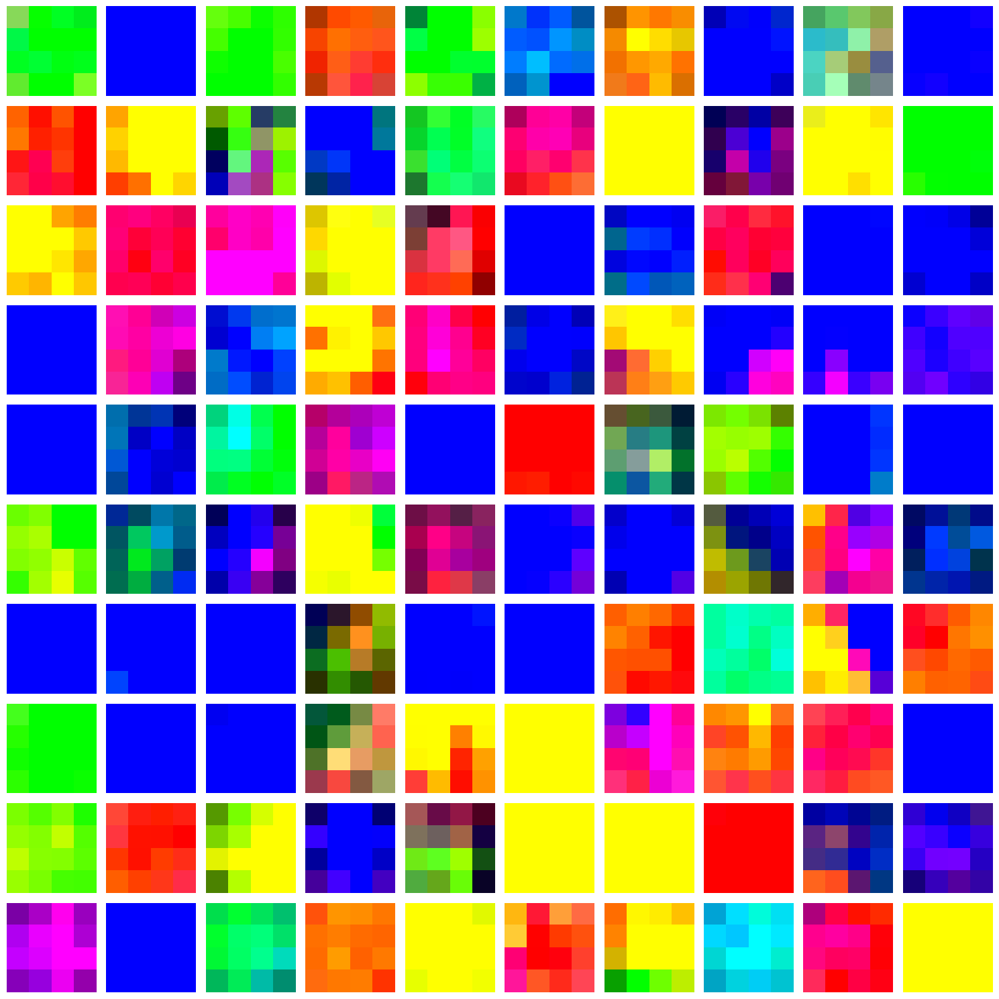

FID score at step 0: 65.77323150634766
Curent image size: 8
Epoch [1/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0784, loss_critic=-3.54]


Epoch [2/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0599, loss_critic=-2.17]


Epoch [3/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0475, loss_critic=-3.79]


Epoch [4/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0384, loss_critic=-2.55]


Epoch [5/ 35


100%|██████████| 40/40 [00:44<00:00,  1.10s/it, gp=0.0451, loss_critic=-2.89]


Epoch [6/ 35


100%|██████████| 40/40 [00:44<00:00,  1.10s/it, gp=0.0421, loss_critic=-2.6] 


Epoch [7/ 35


100%|██████████| 40/40 [00:43<00:00,  1.09s/it, gp=0.0624, loss_critic=-2.86]


Epoch [8/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0384, loss_critic=-3.7] 


Epoch [9/ 35


100%|██████████| 40/40 [00:43<00:00,  1.09s/it, gp=0.0442, loss_critic=-3.43]


Epoch [10/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.044, loss_critic=-4.12] 


Epoch [11/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.0623, loss_critic=-2.87]


Epoch [12/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.0509, loss_critic=-4.74]


Epoch [13/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0251, loss_critic=-3.34]


Epoch [14/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0542, loss_critic=-3.19]


Epoch [15/ 35


100%|██████████| 40/40 [00:43<00:00,  1.09s/it, gp=0.0746, loss_critic=-4.21]


Epoch [16/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.114, loss_critic=-5.33]  


Epoch [17/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.0386, loss_critic=-3.37]


Epoch [18/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.0509, loss_critic=-4.48]


Epoch [19/ 35


100%|██████████| 40/40 [00:43<00:00,  1.09s/it, gp=0.0624, loss_critic=-2.74]


Epoch [20/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.037, loss_critic=-3.79] 


Epoch [21/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.0279, loss_critic=-3.23]


Epoch [22/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0433, loss_critic=-3.9] 


Epoch [23/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0179, loss_critic=-2.84]


Epoch [24/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0377, loss_critic=-2.25]


Epoch [25/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0465, loss_critic=-2.94]


Epoch [26/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.0428, loss_critic=-2.7] 


Epoch [27/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0309, loss_critic=-3.2] 


Epoch [28/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0342, loss_critic=-2.3] 


Epoch [29/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0139, loss_critic=-1.98]


Epoch [30/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.0173, loss_critic=-2.22]


Epoch [31/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0303, loss_critic=-3.27]


Epoch [32/ 35


100%|██████████| 40/40 [00:43<00:00,  1.08s/it, gp=0.0277, loss_critic=-2.63]


Epoch [33/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.0186, loss_critic=-1.96]


Epoch [34/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.0316, loss_critic=-2.14]


Epoch [35/ 35


100%|██████████| 40/40 [00:42<00:00,  1.07s/it, gp=0.0319, loss_critic=-1.34]


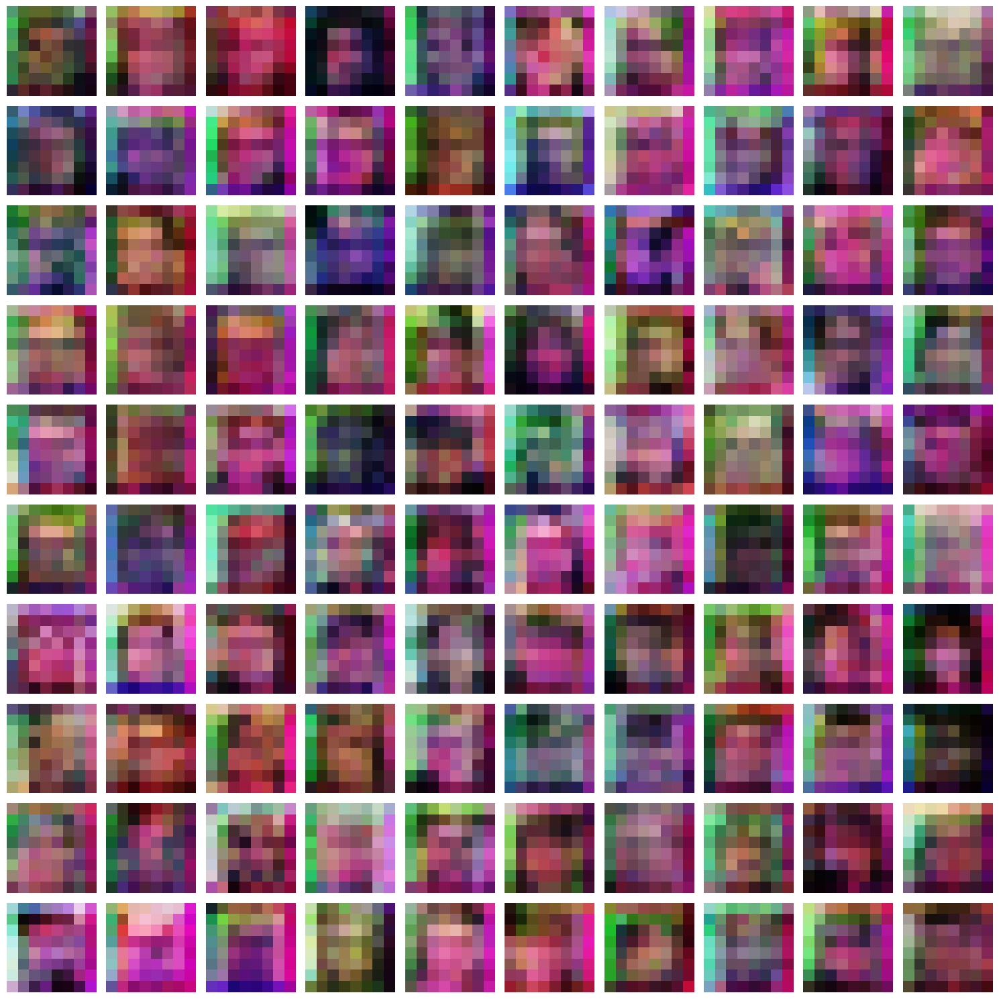

FID score at step 1: 61.62006759643555
Curent image size: 16
Epoch [1/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.113, loss_critic=-3.9]  


Epoch [2/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0892, loss_critic=-2.91]


Epoch [3/ 35


100%|██████████| 79/79 [00:52<00:00,  1.49it/s, gp=0.0209, loss_critic=-3.75]


Epoch [4/ 35


100%|██████████| 79/79 [00:52<00:00,  1.50it/s, gp=0.0429, loss_critic=-1.9] 


Epoch [5/ 35


100%|██████████| 79/79 [00:52<00:00,  1.50it/s, gp=0.0364, loss_critic=-3.63]


Epoch [6/ 35


100%|██████████| 79/79 [00:53<00:00,  1.49it/s, gp=0.09, loss_critic=-4.76]  


Epoch [7/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0167, loss_critic=-3.31]


Epoch [8/ 35


100%|██████████| 79/79 [00:52<00:00,  1.49it/s, gp=0.0523, loss_critic=-5.36]


Epoch [9/ 35


100%|██████████| 79/79 [00:53<00:00,  1.49it/s, gp=0.121, loss_critic=-5.74] 


Epoch [10/ 35


100%|██████████| 79/79 [00:54<00:00,  1.44it/s, gp=0.041, loss_critic=-6.17] 


Epoch [11/ 35


100%|██████████| 79/79 [00:55<00:00,  1.41it/s, gp=0.071, loss_critic=-3.43] 


Epoch [12/ 35


100%|██████████| 79/79 [00:55<00:00,  1.42it/s, gp=0.0379, loss_critic=-4.07]


Epoch [13/ 35


100%|██████████| 79/79 [00:54<00:00,  1.46it/s, gp=0.0902, loss_critic=-4.19]


Epoch [14/ 35


100%|██████████| 79/79 [00:55<00:00,  1.43it/s, gp=0.0822, loss_critic=-3.96]


Epoch [15/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0243, loss_critic=-3.65]


Epoch [16/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0289, loss_critic=-4.3] 


Epoch [17/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.121, loss_critic=-3.91] 


Epoch [18/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0205, loss_critic=-3.89]


Epoch [19/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0486, loss_critic=-2.85]


Epoch [20/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0164, loss_critic=-4.64]


Epoch [21/ 35


100%|██████████| 79/79 [00:53<00:00,  1.47it/s, gp=0.0776, loss_critic=-3.91]


Epoch [22/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0283, loss_critic=-4.67]


Epoch [23/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.078, loss_critic=-3.37] 


Epoch [24/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0299, loss_critic=-2.55]


Epoch [25/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.031, loss_critic=-2.68] 


Epoch [26/ 35


100%|██████████| 79/79 [00:53<00:00,  1.49it/s, gp=0.0175, loss_critic=-2.59] 


Epoch [27/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0124, loss_critic=-3.12]


Epoch [28/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0463, loss_critic=-2.65]


Epoch [29/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0488, loss_critic=-2.93] 


Epoch [30/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0573, loss_critic=-2.3]  


Epoch [31/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0284, loss_critic=-2.6]  


Epoch [32/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.019, loss_critic=-3.16]  


Epoch [33/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0129, loss_critic=-1.34] 


Epoch [34/ 35


100%|██████████| 79/79 [00:53<00:00,  1.47it/s, gp=0.0169, loss_critic=-2.11] 


Epoch [35/ 35


100%|██████████| 79/79 [00:53<00:00,  1.48it/s, gp=0.0109, loss_critic=-1.9]  


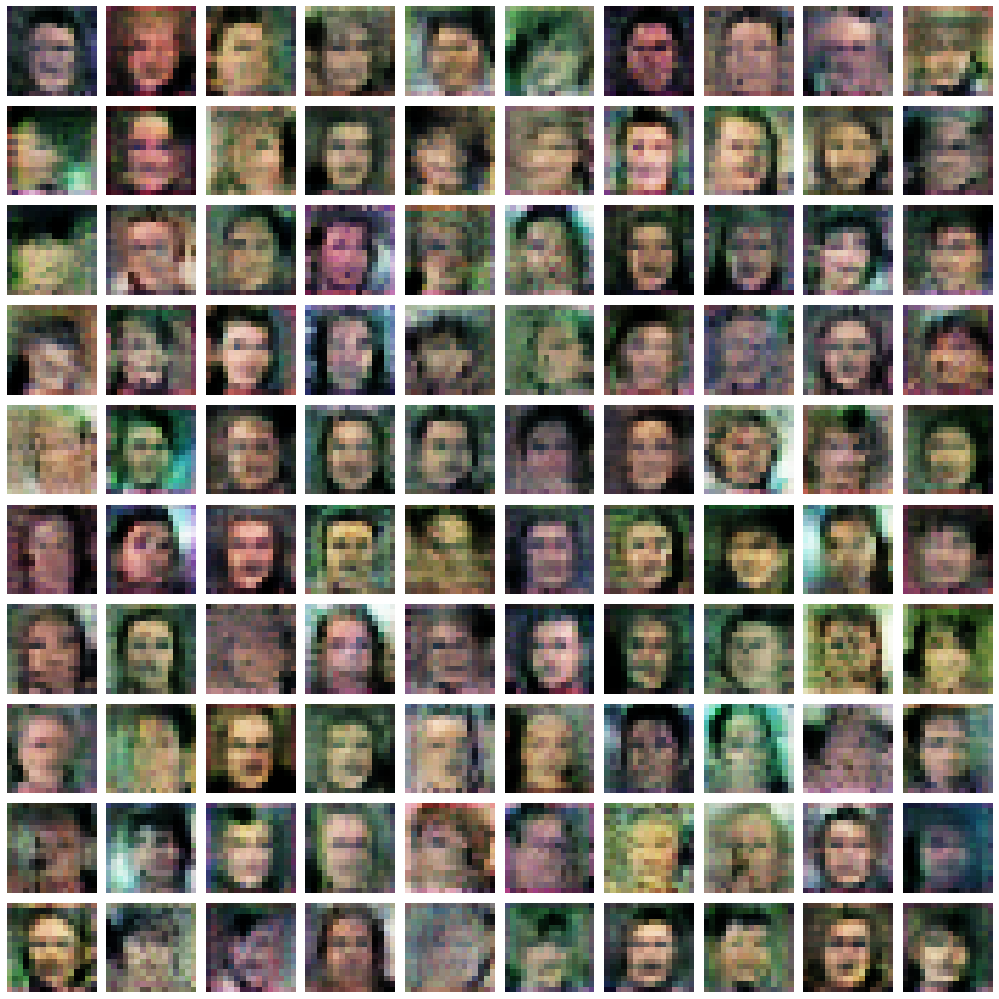

FID score at step 2: 45.898460388183594
Curent image size: 32
Epoch [1/ 35


100%|██████████| 157/157 [01:22<00:00,  1.89it/s, gp=0.14, loss_critic=-6.89]  


Epoch [2/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.095, loss_critic=-5.08] 


Epoch [3/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0176, loss_critic=-2.8] 


Epoch [4/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.00632, loss_critic=-2.71]


Epoch [5/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.043, loss_critic=-3.03] 


Epoch [6/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.059, loss_critic=-4.4]  


Epoch [7/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0351, loss_critic=-3.58] 


Epoch [8/ 35


100%|██████████| 157/157 [01:21<00:00,  1.93it/s, gp=0.112, loss_critic=-3.39] 


Epoch [9/ 35


100%|██████████| 157/157 [01:22<00:00,  1.90it/s, gp=0.0172, loss_critic=-3.56] 


Epoch [10/ 35


100%|██████████| 157/157 [01:22<00:00,  1.90it/s, gp=0.0494, loss_critic=-5.53] 


Epoch [11/ 35


100%|██████████| 157/157 [01:22<00:00,  1.89it/s, gp=0.00606, loss_critic=-2.19]


Epoch [12/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0419, loss_critic=-3.75] 


Epoch [13/ 35


100%|██████████| 157/157 [01:22<00:00,  1.90it/s, gp=0.0265, loss_critic=-2.74] 


Epoch [14/ 35


100%|██████████| 157/157 [01:22<00:00,  1.90it/s, gp=0.0284, loss_critic=-3.27] 


Epoch [15/ 35


100%|██████████| 157/157 [01:22<00:00,  1.90it/s, gp=0.0192, loss_critic=-3.02]


Epoch [16/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0187, loss_critic=-2.56] 


Epoch [17/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0317, loss_critic=-3.95] 


Epoch [18/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0698, loss_critic=-2.9] 


Epoch [19/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.109, loss_critic=-3.92]  


Epoch [20/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0725, loss_critic=-3]   


Epoch [21/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0781, loss_critic=-2.07] 


Epoch [22/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0277, loss_critic=-1.89] 


Epoch [23/ 35


100%|██████████| 157/157 [01:21<00:00,  1.92it/s, gp=0.00622, loss_critic=-2.41]


Epoch [24/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0179, loss_critic=-2.79] 


Epoch [25/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0741, loss_critic=-2.5]  


Epoch [26/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0185, loss_critic=-1.12] 


Epoch [27/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0357, loss_critic=-1.45] 


Epoch [28/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0278, loss_critic=-2.05] 


Epoch [29/ 35


100%|██████████| 157/157 [01:21<00:00,  1.92it/s, gp=0.0456, loss_critic=-1.34] 


Epoch [30/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0281, loss_critic=-1.39] 


Epoch [31/ 35


100%|██████████| 157/157 [01:21<00:00,  1.92it/s, gp=0.0206, loss_critic=-2.29] 


Epoch [32/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.0744, loss_critic=-1.91] 


Epoch [33/ 35


100%|██████████| 157/157 [01:21<00:00,  1.92it/s, gp=0.0406, loss_critic=-2.08] 


Epoch [34/ 35


100%|██████████| 157/157 [01:22<00:00,  1.91it/s, gp=0.011, loss_critic=-1.26]  


Epoch [35/ 35


100%|██████████| 157/157 [01:22<00:00,  1.90it/s, gp=0.0276, loss_critic=-1.38] 


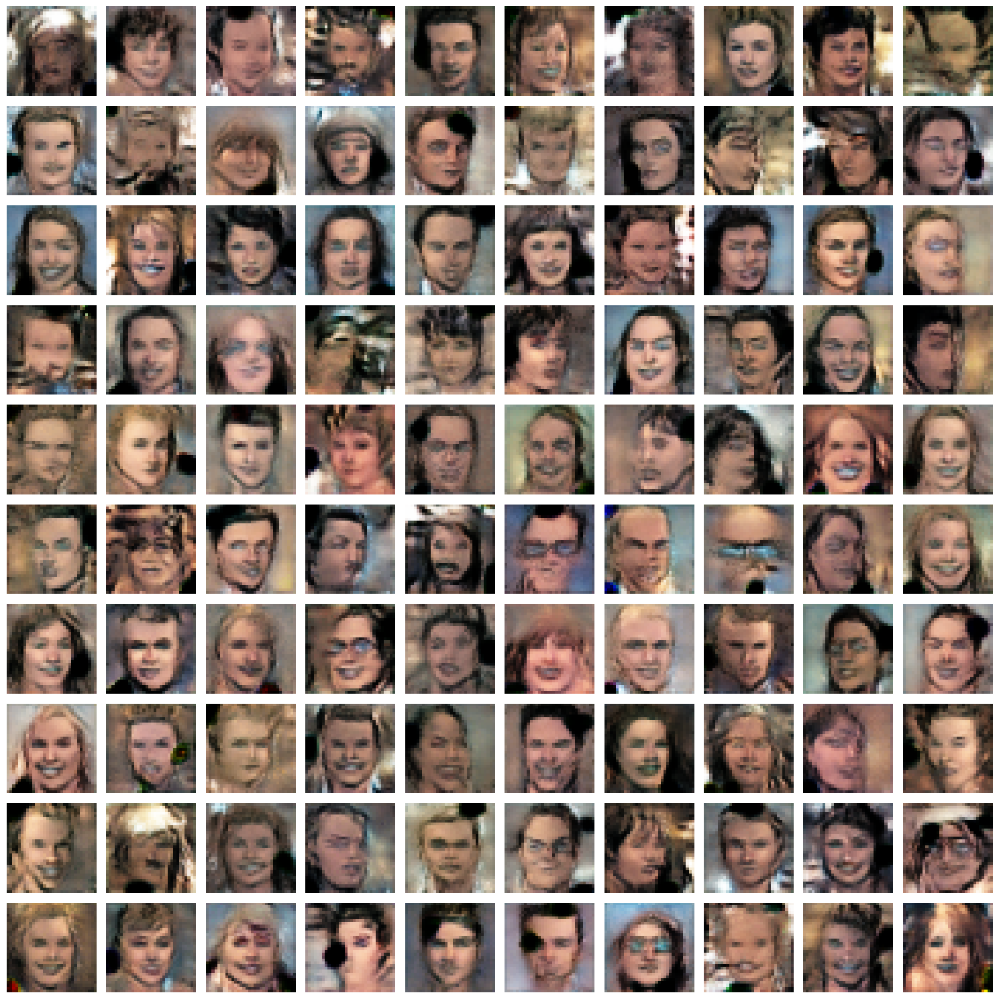

FID score at step 3: 44.14405059814453
Curent image size: 64
Epoch [1/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0513, loss_critic=-4.8]  


Epoch [2/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0156, loss_critic=-4.29] 


Epoch [3/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0749, loss_critic=-5.16]


Epoch [4/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0655, loss_critic=-6.84]


Epoch [5/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0564, loss_critic=-5.55]


Epoch [6/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0525, loss_critic=-6.86]


Epoch [7/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0315, loss_critic=-2.34]


Epoch [8/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0547, loss_critic=-3.11]


Epoch [9/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0364, loss_critic=-4.3] 


Epoch [10/ 35


100%|██████████| 313/313 [02:17<00:00,  2.28it/s, gp=0.0417, loss_critic=-3.24]


Epoch [11/ 35


100%|██████████| 313/313 [02:17<00:00,  2.28it/s, gp=0.0342, loss_critic=-6.06]


Epoch [12/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0447, loss_critic=-5.53]


Epoch [13/ 35


100%|██████████| 313/313 [02:17<00:00,  2.28it/s, gp=0.0395, loss_critic=-3.32]


Epoch [14/ 35


100%|██████████| 313/313 [02:17<00:00,  2.28it/s, gp=0.0591, loss_critic=-1.58]


Epoch [15/ 35


100%|██████████| 313/313 [02:17<00:00,  2.28it/s, gp=0.0432, loss_critic=-6.12]


Epoch [16/ 35


100%|██████████| 313/313 [02:17<00:00,  2.28it/s, gp=0.168, loss_critic=-4.8]  


Epoch [17/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0602, loss_critic=-4.44]


Epoch [18/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0698, loss_critic=-3.13]


Epoch [19/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0202, loss_critic=-2.79]


Epoch [20/ 35


100%|██████████| 313/313 [02:16<00:00,  2.28it/s, gp=0.0274, loss_critic=-4.01]


Epoch [21/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0408, loss_critic=-3.97]


Epoch [22/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0686, loss_critic=-3.99]


Epoch [23/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0583, loss_critic=-4.53] 


Epoch [24/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0366, loss_critic=0.0597]


Epoch [25/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0314, loss_critic=-4.42]


Epoch [26/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0109, loss_critic=-2.43]


Epoch [27/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0264, loss_critic=-1.89] 


Epoch [28/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0236, loss_critic=-2.24] 


Epoch [29/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0266, loss_critic=-2.82]


Epoch [30/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0422, loss_critic=-5.12] 


Epoch [31/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0257, loss_critic=-.177]


Epoch [32/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0341, loss_critic=-2.54]


Epoch [33/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0332, loss_critic=-2.93]


Epoch [34/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0374, loss_critic=-2.43]


Epoch [35/ 35


100%|██████████| 313/313 [02:16<00:00,  2.29it/s, gp=0.0185, loss_critic=-4.28]


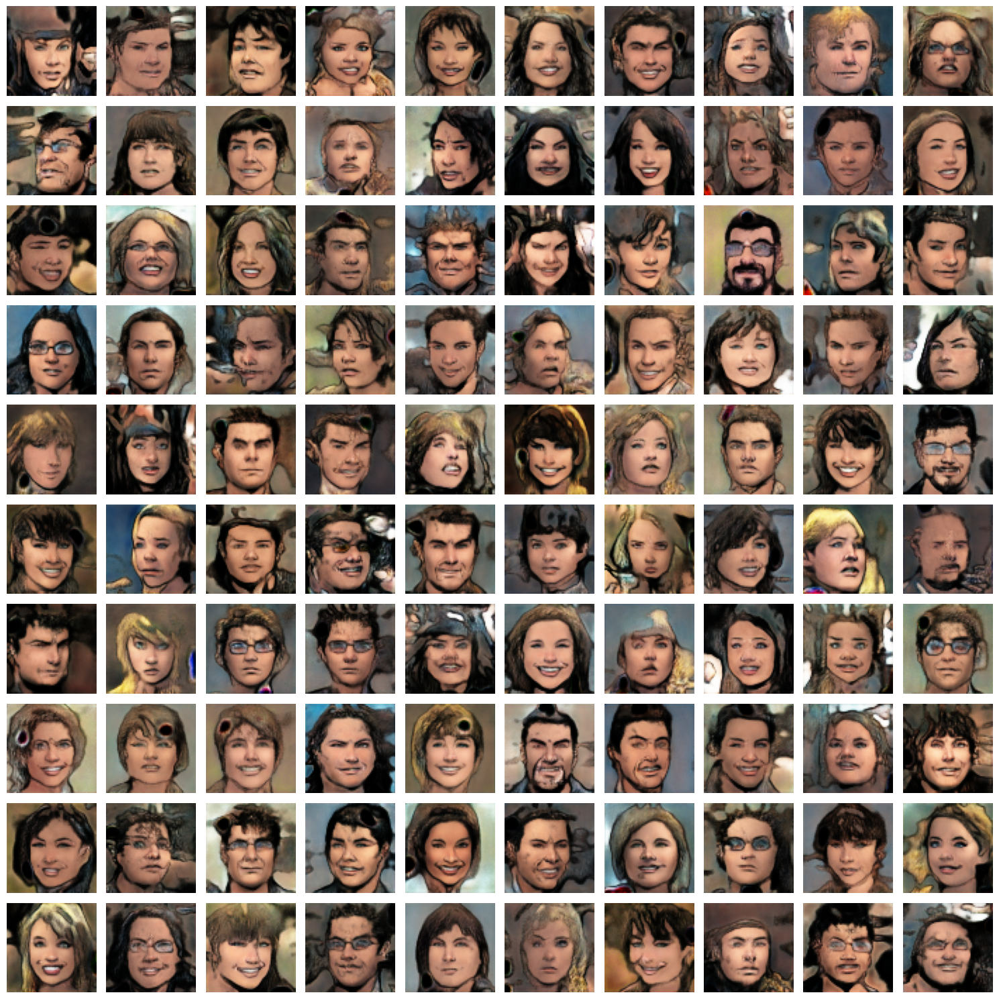

FID score at step 4: 40.80964660644531
Curent image size: 128
Epoch [1/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.181, loss_critic=-14.2] 


Epoch [2/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.203, loss_critic=-7.66] 


Epoch [3/ 35


100%|██████████| 625/625 [03:39<00:00,  2.85it/s, gp=0.199, loss_critic=-11.7] 


Epoch [4/ 35


100%|██████████| 625/625 [03:38<00:00,  2.87it/s, gp=0.27, loss_critic=-12.4]  


Epoch [5/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.265, loss_critic=-6.24] 


Epoch [6/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.145, loss_critic=-5.6]  


Epoch [7/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.137, loss_critic=-2.54] 


Epoch [8/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.26, loss_critic=-7.74]   


Epoch [9/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.138, loss_critic=-4.71] 


Epoch [10/ 35


100%|██████████| 625/625 [03:38<00:00,  2.85it/s, gp=0.154, loss_critic=-12.5] 


Epoch [11/ 35


100%|██████████| 625/625 [03:38<00:00,  2.85it/s, gp=0.147, loss_critic=-4.6]  


Epoch [12/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.175, loss_critic=-10.6] 


Epoch [13/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.0969, loss_critic=-12.2]


Epoch [14/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.128, loss_critic=-8.81] 


Epoch [15/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.187, loss_critic=-9.02] 


Epoch [16/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.1, loss_critic=-4.56]   


Epoch [17/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.185, loss_critic=-4.56] 


Epoch [18/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.135, loss_critic=-7.35] 


Epoch [19/ 35


100%|██████████| 625/625 [03:39<00:00,  2.85it/s, gp=0.15, loss_critic=-7.02]  


Epoch [20/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.127, loss_critic=-13.5] 


Epoch [21/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.119, loss_critic=-14.7] 


Epoch [22/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.0629, loss_critic=-7.81]


Epoch [23/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.0842, loss_critic=-7.9] 


Epoch [24/ 35


100%|██████████| 625/625 [03:39<00:00,  2.85it/s, gp=0.121, loss_critic=-2.79] 


Epoch [25/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.151, loss_critic=-5.69] 


Epoch [26/ 35


100%|██████████| 625/625 [03:39<00:00,  2.85it/s, gp=0.107, loss_critic=-7.07] 


Epoch [27/ 35


100%|██████████| 625/625 [03:39<00:00,  2.85it/s, gp=0.0801, loss_critic=-6.93]


Epoch [28/ 35


100%|██████████| 625/625 [03:38<00:00,  2.85it/s, gp=0.0658, loss_critic=-5.07]


Epoch [29/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.143, loss_critic=-.161] 


Epoch [30/ 35


100%|██████████| 625/625 [03:38<00:00,  2.85it/s, gp=0.112, loss_critic=-9.99] 


Epoch [31/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.125, loss_critic=-5.05] 


Epoch [32/ 35


100%|██████████| 625/625 [03:38<00:00,  2.85it/s, gp=0.0736, loss_critic=-5.7] 


Epoch [33/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.0992, loss_critic=-2.97]


Epoch [34/ 35


100%|██████████| 625/625 [03:38<00:00,  2.87it/s, gp=0.0835, loss_critic=-4.82] 


Epoch [35/ 35


100%|██████████| 625/625 [03:38<00:00,  2.86it/s, gp=0.115, loss_critic=-10]   


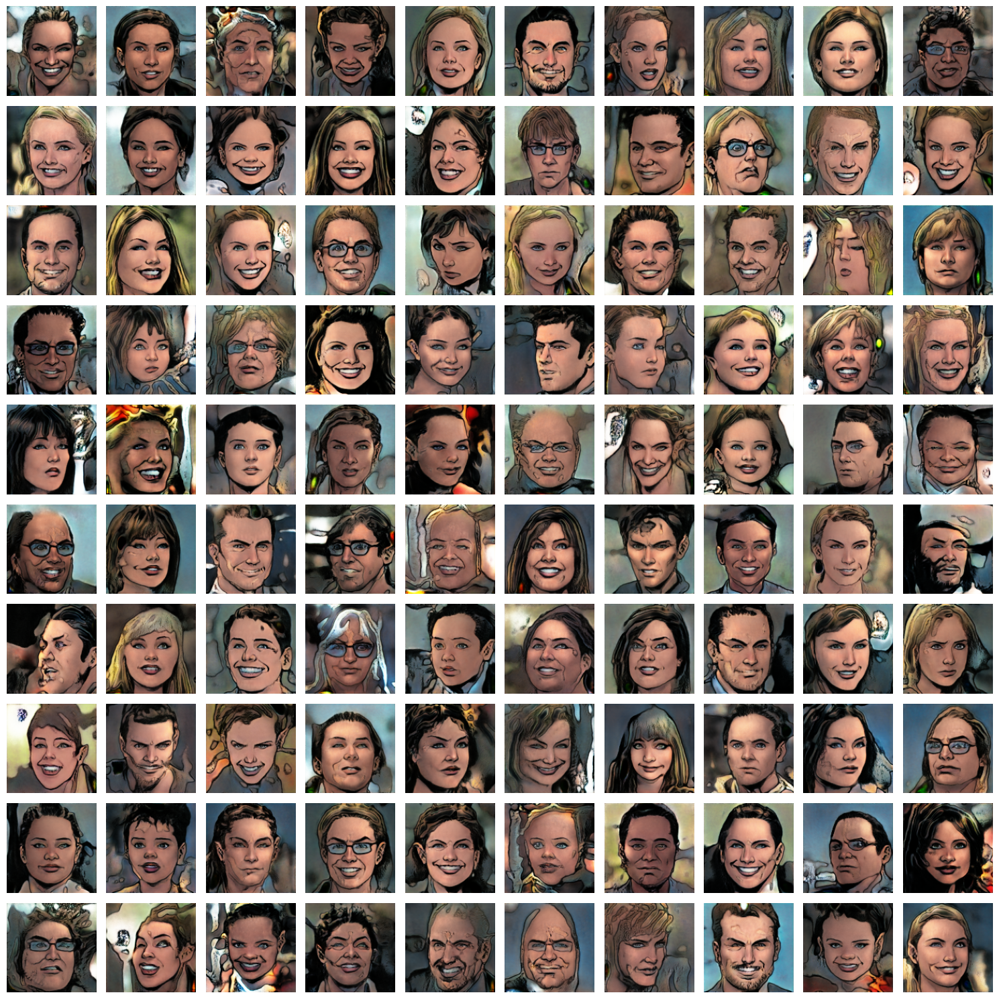

FID score at step 5: 20.44598960876465
FID scores saved to fid_metrics_scores.csv.


In [22]:
# training

gen = Generator(
    Z_DIM, W_DIM, IN_CHANNELS, CHANNELS_IMG
).to(DEVICE)
critic = Discriminator(IN_CHANNELS, CHANNELS_IMG).to(DEVICE)
opt_gen = optim.Adam([{'params': [param for name, param in gen.named_parameters() if 'map' not in name]},
                     {'params': gen.map.parameters(), 'lr': 1e-5}], lr=LR, betas =(0.0, 0.99))
opt_critic = optim.Adam(
    critic.parameters(), lr= LR, betas =(0.0, 0.99)
)
gen.train()
critic.train()
step = int(log2(INITIAL_IMG_SIZE / 4))

csv_file_path = "fid_metrics_scores.csv"
header = ["Step", "FID Score"]

with open(csv_file_path, mode="w", newline="") as file:
   writer = csv.writer(file)
   writer.writerow(header)

for num_epochs in PROGRESSIVE_EPOCHS[step:]:
    alpha = 1e-7
    loader, dataset = get_loader(4*2**step)
    print('Curent image size: '+str(4*2**step))

    for epoch in range(num_epochs):
        print(f'Epoch [{epoch + 1}/ {num_epochs}')
        alpha = train_fn(
            critic, gen, loader, dataset, step, alpha, opt_critic, opt_gen
        )
    generate_examples(gen, step)
    
    fid_score = compute_fid_score(gen, loader, step)
    print(f"FID score at step {step}: {fid_score}")
    with open("fid_scores.txt", "a") as f:
       f.write(f"Step {step}: FID = {fid_score}\n")
    
    # Append to CSV file
    with open(csv_file_path, mode="a", newline="") as file:
       writer = csv.writer(file)
       writer.writerow([step, fid_score])

    step +=1
print(f"FID scores saved to {csv_file_path}.")

In [24]:
# save model
save_dir = "saved_models_35"
os.makedirs(save_dir, exist_ok=True)

generator_path = os.path.join(save_dir, 'generator_35.pth')
discriminator_path = os.path.join(save_dir, 'discriminator_35.pth')
optimizer_gen_path = os.path.join(save_dir, 'optimizer_gen_35.pth')
optimizer_critic_path = os.path.join(save_dir, 'optimizer_critic_35.pth')
step_path = os.path.join(save_dir, 'training_step_35.pth')

torch.save(gen.state_dict(), generator_path)
torch.save(critic.state_dict(), discriminator_path)
torch.save(opt_gen.state_dict(), optimizer_gen_path)
torch.save(opt_critic.state_dict(), optimizer_critic_path)

torch.save(step, step_path)

print("Model, optimizers, and steps saved!")

config = {
    "Z_DIM": Z_DIM,
    "W_DIM": W_DIM,
    "IN_CHANNELS": IN_CHANNELS,
    "CHANNELS_IMG": CHANNELS_IMG,
    "LR": LR,
    "BATCH_SIZE": BATCH_SIZES,
    "PROGRESSIVE_EPOCHS": PROGRESSIVE_EPOCHS,
    "INITIAL_IMG_SIZE": INITIAL_IMG_SIZE,
    "DEVICE": DEVICE,
}

config_path = os.path.join(save_dir, 'config_35.pth')
torch.save(config, config_path)

print("Configuration saved!")


Model, optimizers, and steps saved!
Configuration saved!


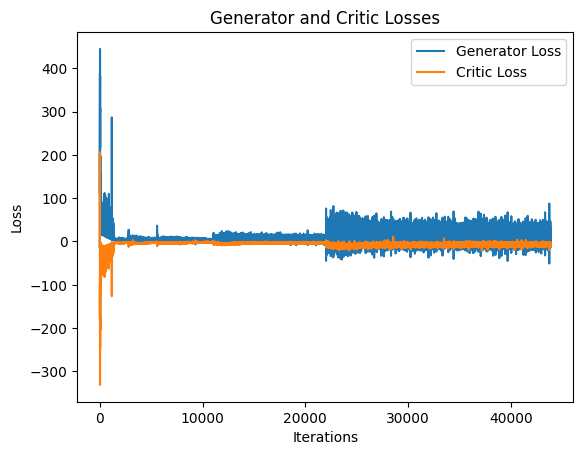

In [25]:
# Plot the losses
plt.figure()
plt.plot(loss_gen_list, label="Generator Loss")
plt.plot(loss_critic_list, label="Critic Loss")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.title("Generator and Critic Losses")
plt.legend()
plt.savefig("loss_plot.png")
plt.show()

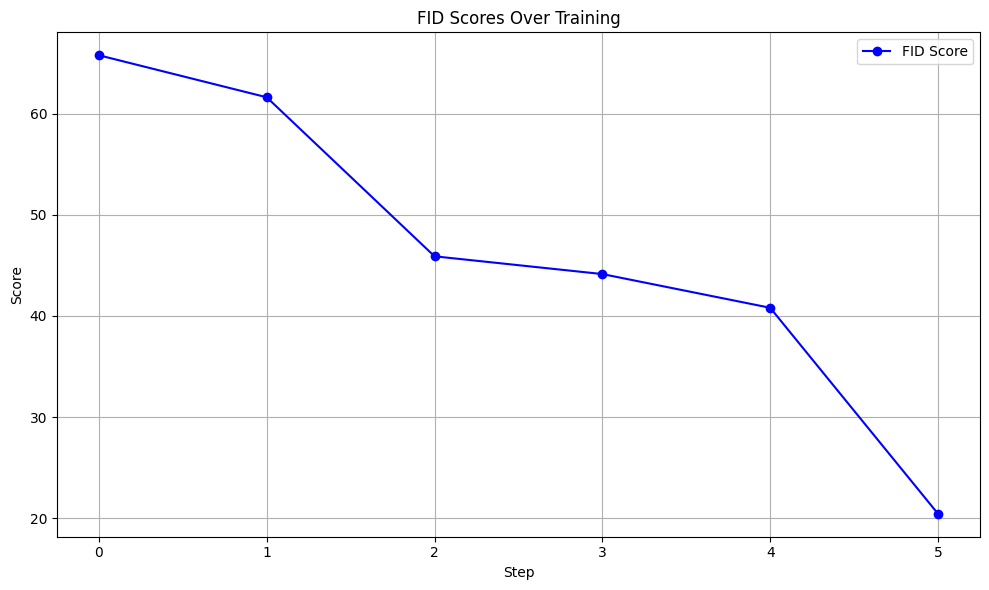

In [31]:
import matplotlib.pyplot as plt
import pandas as pd

# Load the CSV file
data = pd.read_csv("fid_metrics_scores.csv")

# Plot FID and PPL scores over the course of training
plt.figure(figsize=(10, 6))
plt.plot(data['Step'], data['FID Score'], label='FID Score', color='b', linestyle='-', marker='o')
# plt.plot(data['Step'], data['PPL Score'], label='PPL Score', color='r', linestyle='-', marker='x')
plt.xlabel('Step')
plt.ylabel('Score')
plt.title('FID Scores Over Training')
plt.legend()
plt.grid(True)
plt.tight_layout()

# Save the plot
plt.savefig("metrics_plot.png")
plt.show()


In [24]:
# Compute PPL from the saved models and configurations
save_dir = "saved_models_35"
config_path = os.path.join(save_dir, 'config_35.pth')
config = torch.load(config_path)

# Extract configuration parameters
DEVICE = config["DEVICE"]
Z_DIM = config["Z_DIM"]
W_DIM = config["W_DIM"]
IN_CHANNELS = config["IN_CHANNELS"]
CHANNELS_IMG = config["CHANNELS_IMG"]

generator_path = os.path.join(save_dir, 'generator_35.pth')

gen = Generator(
    z_dim=Z_DIM,
    w_dim=W_DIM,
    in_channels=IN_CHANNELS,
    img_channels=CHANNELS_IMG
).to(DEVICE)
gen.load_state_dict(torch.load(generator_path))
gen.eval()  

step_path = os.path.join(save_dir, 'training_step_35.pth')
step = torch.load(step_path)

ppl_score = compute_ppl(gen, step, num_samples=10000, eps=1e-4, batch_size=10)
print(f"PPL Score: {ppl_score}")


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/vgg16-397923af.pth" to /root/.cache/torch/hub/checkpoints/vgg16-397923af.pth
100%|██████████| 528M/528M [00:06<00:00, 80.5MB/s] 


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


Computing PPL: 100%|██████████| 1000/1000 [00:43<00:00, 23.19it/s]

PPL Score: 35302734.375


In [26]:
# Compute PPL from the saved models and configurations
save_dir = "saved_models_35"
config_path = os.path.join(save_dir, 'config_35.pth')
config = torch.load(config_path)

# Extract configuration parameters
DEVICE = config["DEVICE"]
Z_DIM = config["Z_DIM"]
W_DIM = config["W_DIM"]
IN_CHANNELS = config["IN_CHANNELS"]
CHANNELS_IMG = config["CHANNELS_IMG"]

generator_path = os.path.join(save_dir, 'generator_35.pth')

gen = Generator(
    z_dim=Z_DIM,
    w_dim=W_DIM,
    in_channels=IN_CHANNELS,
    img_channels=CHANNELS_IMG
).to(DEVICE)
gen.load_state_dict(torch.load(generator_path))
gen.eval()  

step_path = os.path.join(save_dir, 'training_step_35.pth')
step = torch.load(step_path)

ppl_score = compute_ppl(gen, step, num_samples=10000, eps=1e-4, batch_size=64)
print(f"PPL Score: {ppl_score}")


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


Computing PPL: 100%|██████████| 156/156 [00:46<00:00,  3.35it/s]


PPL Score: 35253906.25


# 45 epochs

In [31]:
pip install torch-fidelity

Note: you may need to restart the kernel to use updated packages.


In [30]:
# Hyperparameters

DATASET = 'STYLEGAN/train'
INITIAL_IMG_SIZE = 4
DEVICE = 'cuda' if torch.cuda.is_available() else 'cpu'
LR = 1e-3
BATCH_SIZES = [256,256,128,64,32,16]
CHANNELS_IMG = 3
Z_DIM = 512
W_DIM = 512
IN_CHANNELS = 512
LAMBDA_GP = 10
PROGRESSIVE_EPOCHS = [45] * len(BATCH_SIZES)

# Tracking losses
loss_gen_list_45 = []
loss_critic_list_45 = []


In [31]:
# This function takes generator gen, number of steps to identify current resolution and number n=100. 
# This function generates n fake images and save them as result

def generate_examples(gen, steps, n=100, grid_size=(10, 10)):
    gen.eval()
    alpha = 1.0
    generated_images = []
    for i in range(n):
        with torch.no_grad():
            noise = torch.randn(1, Z_DIM).to(DEVICE) 
            alpha = 1.0 
            img = gen(noise, alpha, steps) 
            img_rescaled = (img + 1) / 2
            img_rescaled = img_rescaled.clamp(0, 1) 
                      
            if not os.path.exists(f'saved_examples_45/step{steps}'):
                os.makedirs(f'saved_examples_45/step{steps}')
            save_path = f'saved_examples_45/step{steps}/image_{i}.png'
            torchvision.utils.save_image(img, save_path)
            generated_images.append(img_rescaled.squeeze(0))
    fig, axes = plt.subplots(grid_size[0], grid_size[1], figsize=(15, 15))
    axes = axes.flatten()     
    for i in range(len(generated_images)):
        ax = axes[i]
        ax.imshow(np.transpose(generated_images[i].cpu().numpy(), (1, 2, 0)))  
        ax.axis('off') 
    plt.tight_layout()
    plt.show()
    gen.train()  


In [32]:
# train function - sending the critic(discriminator), gen(generator), loader, dataset, step, alpha, and optimiser for generator and critic 
def train_fn(
    critic,
    gen,
    loader,
    dataset,
    step,
    alpha,
    opt_critic,
    opt_gen
):
    loop = tqdm(loader, leave=True)

    for batch_idx, (real, _) in enumerate(loop):
        real = real.to(DEVICE)
        cur_batch_size = real.shape[0]
        noise = torch.randn(cur_batch_size, Z_DIM).to(DEVICE)
        fake  = gen(noise, alpha, step)
        critic_real = critic(real, alpha, step)
        critic_fake = critic(fake.detach(), alpha, step)
        gp = gradient_penalty(critic, real, fake, alpha, step, DEVICE)
        loss_critic = (
            -(torch.mean(critic_real) - torch.mean(critic_fake))
            + LAMBDA_GP * gp
            + (0.001) * torch.mean(critic_real ** 2)
        )

        critic.zero_grad()
        loss_critic.backward()
        opt_critic.step()
        loss_critic_list_45.append(loss_critic.item())

        gen_fake = critic(fake, alpha, step)
        loss_gen = -torch.mean(gen_fake)

        gen.zero_grad()
        loss_gen.backward()
        opt_gen.step()
        loss_gen_list_45.append(loss_gen.item())

        alpha += cur_batch_size / (
            PROGRESSIVE_EPOCHS[step] * 0.5 * len(dataset)
        )
        alpha = min(alpha,1)


        loop.set_postfix(
            gp = gp.item(),
            loss_critic = loss_critic.item()
        )
    return alpha



Curent image size: 4
Epoch [1/ 45


100%|██████████| 40/40 [00:39<00:00,  1.01it/s, gp=3.57, loss_critic=-88.1]  


Epoch [2/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=3.33, loss_critic=-11.7]


Epoch [3/ 45


100%|██████████| 40/40 [00:38<00:00,  1.05it/s, gp=1.41, loss_critic=-11.2]


Epoch [4/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.877, loss_critic=-14.3]


Epoch [5/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.794, loss_critic=-15.6]


Epoch [6/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.646, loss_critic=-11.6]


Epoch [7/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.604, loss_critic=-8.93]


Epoch [8/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.484, loss_critic=-15.5]


Epoch [9/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.579, loss_critic=-21.6]


Epoch [10/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.601, loss_critic=-12.5]


Epoch [11/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.409, loss_critic=-16.6]


Epoch [12/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.52, loss_critic=-18.5] 


Epoch [13/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.589, loss_critic=-11.9]


Epoch [14/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.524, loss_critic=-24.4]


Epoch [15/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.391, loss_critic=-11.5]


Epoch [16/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.366, loss_critic=-13.7]


Epoch [17/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.322, loss_critic=-8.44]


Epoch [18/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.486, loss_critic=-21.5]


Epoch [19/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.342, loss_critic=-15.3]


Epoch [20/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.269, loss_critic=-9.69]


Epoch [21/ 45


100%|██████████| 40/40 [00:39<00:00,  1.01it/s, gp=0.274, loss_critic=-15.2]


Epoch [22/ 45


100%|██████████| 40/40 [00:40<00:00,  1.02s/it, gp=0.23, loss_critic=-9.59] 


Epoch [23/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.277, loss_critic=-12]  


Epoch [24/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.225, loss_critic=-7.16]


Epoch [25/ 45


100%|██████████| 40/40 [00:38<00:00,  1.05it/s, gp=0.191, loss_critic=-10.1]


Epoch [26/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.149, loss_critic=-10.1]


Epoch [27/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.149, loss_critic=-9.16]


Epoch [28/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.124, loss_critic=-6.75]


Epoch [29/ 45


100%|██████████| 40/40 [00:38<00:00,  1.05it/s, gp=0.107, loss_critic=-5.45] 


Epoch [30/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.135, loss_critic=-4.94] 


Epoch [31/ 45


100%|██████████| 40/40 [00:38<00:00,  1.05it/s, gp=0.0962, loss_critic=-8.49]


Epoch [32/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.154, loss_critic=-4.98] 


Epoch [33/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.1, loss_critic=-3.86]   


Epoch [34/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0777, loss_critic=-3.57]


Epoch [35/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.0483, loss_critic=-2.49]


Epoch [36/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0816, loss_critic=-4.34]


Epoch [37/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0836, loss_critic=-5.9] 


Epoch [38/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.0453, loss_critic=-2.59]


Epoch [39/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.027, loss_critic=-4.34] 


Epoch [40/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.0789, loss_critic=-2.95]


Epoch [41/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0358, loss_critic=-5.52]


Epoch [42/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0507, loss_critic=-2.37]


Epoch [43/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0303, loss_critic=-2.58]


Epoch [44/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0446, loss_critic=-2.09]


Epoch [45/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.0355, loss_critic=-3.41]


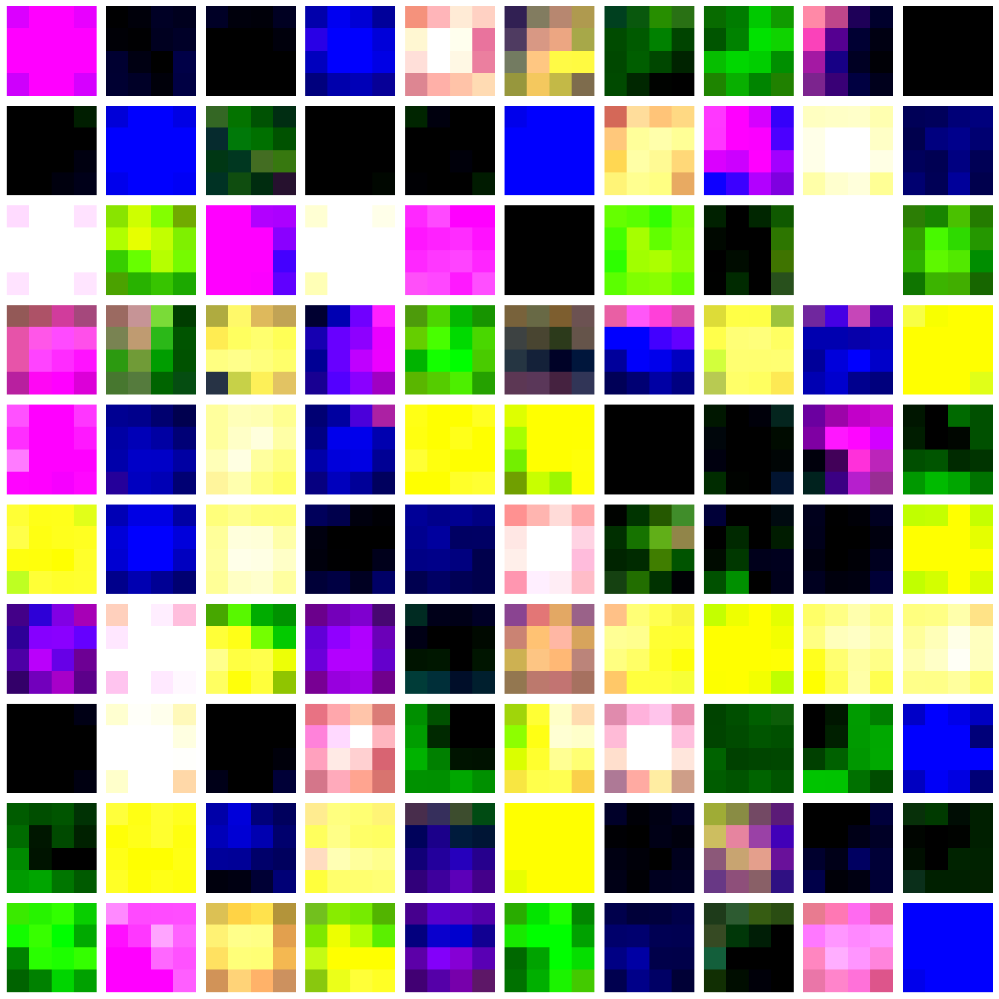

FID score at step 0: 64.32276153564453
Curent image size: 8
Epoch [1/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0329, loss_critic=-1.95]


Epoch [2/ 45


100%|██████████| 40/40 [00:39<00:00,  1.03it/s, gp=0.0243, loss_critic=-1.53]


Epoch [3/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0325, loss_critic=-2.3] 


Epoch [4/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0399, loss_critic=-1.51]


Epoch [5/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.038, loss_critic=-1.69] 


Epoch [6/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0402, loss_critic=-2.37]


Epoch [7/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0253, loss_critic=-2.04]


Epoch [8/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0131, loss_critic=-1.71]


Epoch [9/ 45


100%|██████████| 40/40 [00:39<00:00,  1.01it/s, gp=0.0283, loss_critic=-2.36]


Epoch [10/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.00288, loss_critic=-2.08]


Epoch [11/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0327, loss_critic=-1.92]


Epoch [12/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0445, loss_critic=-2.6] 


Epoch [13/ 45


100%|██████████| 40/40 [00:39<00:00,  1.01it/s, gp=0.022, loss_critic=-3.4]  


Epoch [14/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0174, loss_critic=-2.44]


Epoch [15/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0345, loss_critic=-2.64]


Epoch [16/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.0308, loss_critic=-3.23]


Epoch [17/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0282, loss_critic=-2.53]


Epoch [18/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0388, loss_critic=-3.5] 


Epoch [19/ 45


100%|██████████| 40/40 [00:39<00:00,  1.01it/s, gp=0.0243, loss_critic=-2.19]


Epoch [20/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0175, loss_critic=-3.21]


Epoch [21/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.0511, loss_critic=-3.44]


Epoch [22/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0189, loss_critic=-3.34]


Epoch [23/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.029, loss_critic=-3.14] 


Epoch [24/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0259, loss_critic=-2.77]


Epoch [25/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0259, loss_critic=-3.88]


Epoch [26/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0442, loss_critic=-2.16]


Epoch [27/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0277, loss_critic=-2.65]


Epoch [28/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0583, loss_critic=-2.07]


Epoch [29/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.0154, loss_critic=-2]   


Epoch [30/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.039, loss_critic=-2.2]  


Epoch [31/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0238, loss_critic=-1.7]  


Epoch [32/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0256, loss_critic=-1.93]


Epoch [33/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0179, loss_critic=-1.89]


Epoch [34/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.043, loss_critic=-2.67] 


Epoch [35/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.049, loss_critic=-3.05]  


Epoch [36/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.0172, loss_critic=-2.25] 


Epoch [37/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.0408, loss_critic=-2.74]


Epoch [38/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.00393, loss_critic=-1.61]


Epoch [39/ 45


100%|██████████| 40/40 [00:39<00:00,  1.01it/s, gp=0.0108, loss_critic=-1.84]


Epoch [40/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0167, loss_critic=-2.21]


Epoch [41/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0304, loss_critic=-2.48]


Epoch [42/ 45


100%|██████████| 40/40 [00:38<00:00,  1.03it/s, gp=0.04, loss_critic=-1.6]   


Epoch [43/ 45


100%|██████████| 40/40 [00:38<00:00,  1.04it/s, gp=0.0202, loss_critic=-2.26] 


Epoch [44/ 45


100%|██████████| 40/40 [00:37<00:00,  1.06it/s, gp=0.0271, loss_critic=-1.93]


Epoch [45/ 45


100%|██████████| 40/40 [00:39<00:00,  1.02it/s, gp=0.0234, loss_critic=-2.27]


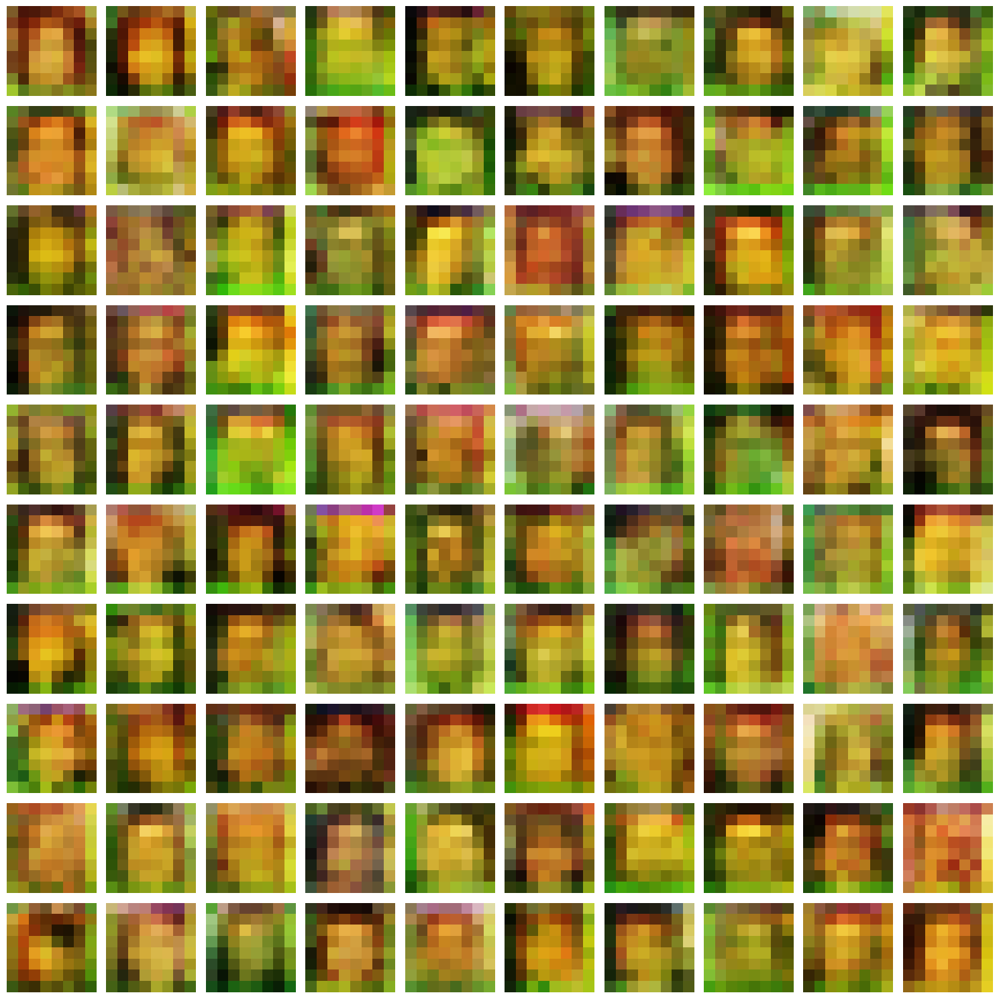

FID score at step 1: 81.63189697265625
Curent image size: 16
Epoch [1/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.041, loss_critic=-3.12] 


Epoch [2/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.045, loss_critic=-1.98] 


Epoch [3/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0824, loss_critic=-3.76]


Epoch [4/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0745, loss_critic=-1.34]


Epoch [5/ 45


100%|██████████| 79/79 [00:48<00:00,  1.62it/s, gp=0.0355, loss_critic=-3.44]


Epoch [6/ 45


100%|██████████| 79/79 [00:48<00:00,  1.62it/s, gp=0.0175, loss_critic=-2.46]


Epoch [7/ 45


100%|██████████| 79/79 [00:49<00:00,  1.61it/s, gp=0.0568, loss_critic=-3.17]


Epoch [8/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0104, loss_critic=-3.1] 


Epoch [9/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0148, loss_critic=-2.26]


Epoch [10/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.133, loss_critic=-3.29] 


Epoch [11/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0304, loss_critic=-2.91]


Epoch [12/ 45


100%|██████████| 79/79 [00:49<00:00,  1.59it/s, gp=0.0112, loss_critic=-3.66] 


Epoch [13/ 45


100%|██████████| 79/79 [00:48<00:00,  1.61it/s, gp=0.00445, loss_critic=-2.73]


Epoch [14/ 45


100%|██████████| 79/79 [00:49<00:00,  1.61it/s, gp=0.0392, loss_critic=-2.65]


Epoch [15/ 45


100%|██████████| 79/79 [00:49<00:00,  1.61it/s, gp=0.0509, loss_critic=-3.49]


Epoch [16/ 45


100%|██████████| 79/79 [00:49<00:00,  1.61it/s, gp=0.0641, loss_critic=-2.92]


Epoch [17/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0829, loss_critic=-3.18]


Epoch [18/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.011, loss_critic=-3.41] 


Epoch [19/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0368, loss_critic=-3.57]


Epoch [20/ 45


100%|██████████| 79/79 [00:48<00:00,  1.62it/s, gp=0.0271, loss_critic=-2.72]


Epoch [21/ 45


100%|██████████| 79/79 [00:48<00:00,  1.61it/s, gp=0.047, loss_critic=-3.78] 


Epoch [22/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0102, loss_critic=-2.87]


Epoch [23/ 45


100%|██████████| 79/79 [00:49<00:00,  1.61it/s, gp=0.0429, loss_critic=-2.88]


Epoch [24/ 45


100%|██████████| 79/79 [00:48<00:00,  1.61it/s, gp=0.0148, loss_critic=-2.3] 


Epoch [25/ 45


100%|██████████| 79/79 [00:49<00:00,  1.61it/s, gp=0.0453, loss_critic=-2.75] 


Epoch [26/ 45


100%|██████████| 79/79 [00:49<00:00,  1.59it/s, gp=0.0579, loss_critic=-3.33] 


Epoch [27/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0149, loss_critic=-2.89]


Epoch [28/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0327, loss_critic=-1.32]


Epoch [29/ 45


100%|██████████| 79/79 [00:49<00:00,  1.61it/s, gp=0.0362, loss_critic=-3.35] 


Epoch [30/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.046, loss_critic=-2.12] 


Epoch [31/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0163, loss_critic=-2.56] 


Epoch [32/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0814, loss_critic=-1.89] 


Epoch [33/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0117, loss_critic=-1.66] 


Epoch [34/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.00714, loss_critic=-1.49]


Epoch [35/ 45


100%|██████████| 79/79 [00:49<00:00,  1.61it/s, gp=0.0149, loss_critic=-1.52] 


Epoch [36/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0155, loss_critic=-.94]  


Epoch [37/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0469, loss_critic=-2.25] 


Epoch [38/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.00285, loss_critic=-1.12]


Epoch [39/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.0658, loss_critic=-1.6]  


Epoch [40/ 45


100%|██████████| 79/79 [00:49<00:00,  1.60it/s, gp=0.00354, loss_critic=-.9]  


Epoch [41/ 45


100%|██████████| 79/79 [00:49<00:00,  1.61it/s, gp=0.00967, loss_critic=-1.63]


Epoch [42/ 45


100%|██████████| 79/79 [00:49<00:00,  1.61it/s, gp=0.0151, loss_critic=-1.79] 


Epoch [43/ 45


100%|██████████| 79/79 [00:49<00:00,  1.61it/s, gp=0.0128, loss_critic=-1.67] 


Epoch [44/ 45


100%|██████████| 79/79 [00:49<00:00,  1.61it/s, gp=0.0216, loss_critic=-.785] 


Epoch [45/ 45


100%|██████████| 79/79 [00:48<00:00,  1.62it/s, gp=0.00697, loss_critic=-1.75]


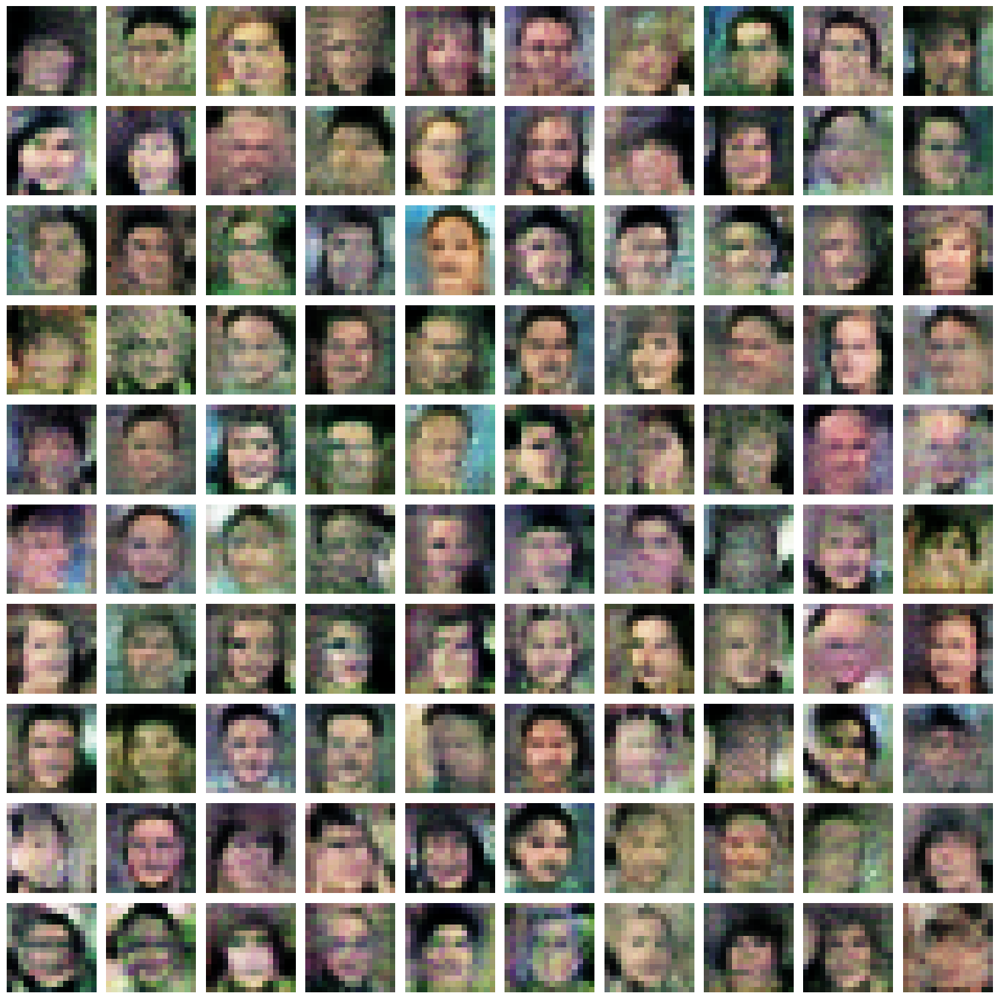

FID score at step 2: 50.41876220703125
Curent image size: 32
Epoch [1/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.00913, loss_critic=-2.79]


Epoch [2/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.00403, loss_critic=-2.79]


Epoch [3/ 45


100%|██████████| 157/157 [01:18<00:00,  2.01it/s, gp=0.0163, loss_critic=-2.31] 


Epoch [4/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0227, loss_critic=-2.44] 


Epoch [5/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.028, loss_critic=-3.38]  


Epoch [6/ 45


100%|██████████| 157/157 [01:18<00:00,  1.99it/s, gp=0.0127, loss_critic=-2.68] 


Epoch [7/ 45


100%|██████████| 157/157 [01:18<00:00,  2.01it/s, gp=0.11, loss_critic=-3.12]  


Epoch [8/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0342, loss_critic=-1.6]  


Epoch [9/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.00532, loss_critic=-3.83]


Epoch [10/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.11, loss_critic=-3.35]   


Epoch [11/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.00768, loss_critic=-3.4] 


Epoch [12/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0549, loss_critic=-3.15]


Epoch [13/ 45


100%|██████████| 157/157 [01:17<00:00,  2.02it/s, gp=0.0146, loss_critic=-2.64] 


Epoch [14/ 45


100%|██████████| 157/157 [01:17<00:00,  2.03it/s, gp=0.0203, loss_critic=-3.19] 


Epoch [15/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0204, loss_critic=-1.9]  


Epoch [16/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0903, loss_critic=-1.39] 


Epoch [17/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.026, loss_critic=-2.27]  


Epoch [18/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0871, loss_critic=-.295] 


Epoch [19/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0501, loss_critic=-1.49] 


Epoch [20/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0431, loss_critic=-2.1]  


Epoch [21/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.00536, loss_critic=-1.41]


Epoch [22/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0185, loss_critic=-1.62] 


Epoch [23/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0243, loss_critic=-1.65] 


Epoch [24/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0613, loss_critic=-1.87] 


Epoch [25/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.00347, loss_critic=-2.57]


Epoch [26/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0064, loss_critic=-1.61] 


Epoch [27/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.00968, loss_critic=-2.28]


Epoch [28/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0125, loss_critic=-.987] 


Epoch [29/ 45


100%|██████████| 157/157 [01:18<00:00,  1.99it/s, gp=0.0408, loss_critic=-1.06] 


Epoch [30/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0118, loss_critic=-1.96] 


Epoch [31/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0657, loss_critic=-.994] 


Epoch [32/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0394, loss_critic=-.128] 


Epoch [33/ 45


100%|██████████| 157/157 [01:18<00:00,  2.01it/s, gp=0.0216, loss_critic=-.754] 


Epoch [34/ 45


100%|██████████| 157/157 [01:17<00:00,  2.02it/s, gp=0.00809, loss_critic=-1.23]


Epoch [35/ 45


100%|██████████| 157/157 [01:17<00:00,  2.02it/s, gp=0.00896, loss_critic=-1.85]


Epoch [36/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.00787, loss_critic=-1.64]


Epoch [37/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0551, loss_critic=-.986] 


Epoch [38/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0101, loss_critic=-2.13] 


Epoch [39/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.00788, loss_critic=-.689]


Epoch [40/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0276, loss_critic=-.874] 


Epoch [41/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.021, loss_critic=-1.04]  


Epoch [42/ 45


100%|██████████| 157/157 [01:18<00:00,  2.00it/s, gp=0.0052, loss_critic=-2.48] 


Epoch [43/ 45


100%|██████████| 157/157 [01:18<00:00,  2.01it/s, gp=0.00352, loss_critic=-.593]


Epoch [44/ 45


100%|██████████| 157/157 [01:17<00:00,  2.02it/s, gp=0.0494, loss_critic=-1.27] 


Epoch [45/ 45


100%|██████████| 157/157 [01:17<00:00,  2.02it/s, gp=0.0134, loss_critic=-1.79] 


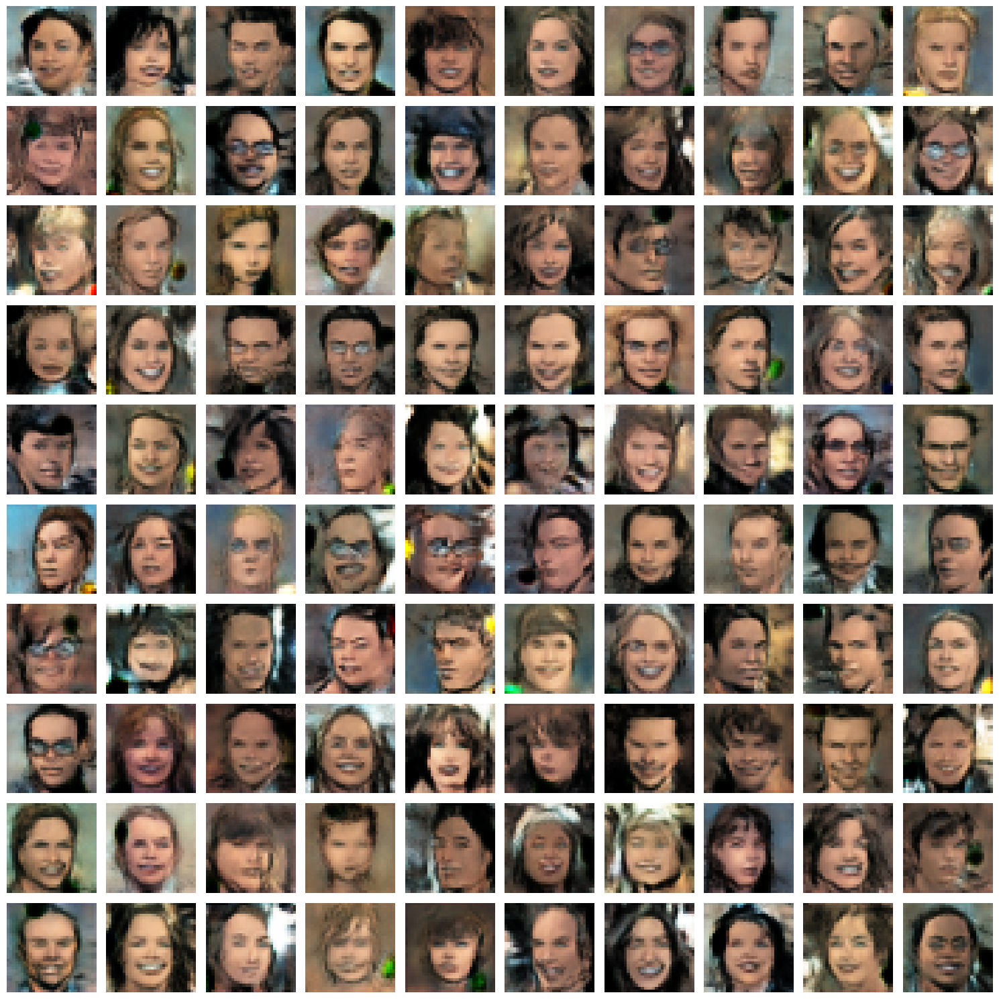

FID score at step 3: 31.68584632873535
Curent image size: 64
Epoch [1/ 45


100%|██████████| 313/313 [02:12<00:00,  2.37it/s, gp=0.0194, loss_critic=-3.75] 


Epoch [2/ 45


100%|██████████| 313/313 [02:12<00:00,  2.35it/s, gp=0.148, loss_critic=-3.74] 


Epoch [3/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0902, loss_critic=-3.88] 


Epoch [4/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0595, loss_critic=-4.14]


Epoch [5/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.047, loss_critic=-5.48] 


Epoch [6/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.046, loss_critic=-5.43] 


Epoch [7/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0547, loss_critic=-6.09]


Epoch [8/ 45


100%|██████████| 313/313 [02:12<00:00,  2.37it/s, gp=0.0884, loss_critic=-4.45]


Epoch [9/ 45


100%|██████████| 313/313 [02:12<00:00,  2.37it/s, gp=0.0338, loss_critic=-7.48]


Epoch [10/ 45


100%|██████████| 313/313 [02:12<00:00,  2.37it/s, gp=0.0251, loss_critic=-4.29]


Epoch [11/ 45


100%|██████████| 313/313 [02:12<00:00,  2.37it/s, gp=0.0378, loss_critic=-4.17]


Epoch [12/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0783, loss_critic=-3.79]


Epoch [13/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0408, loss_critic=-1.38]


Epoch [14/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0305, loss_critic=-4.45]


Epoch [15/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0554, loss_critic=-2.58]


Epoch [16/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0241, loss_critic=-4.9]  


Epoch [17/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0462, loss_critic=-3.94]


Epoch [18/ 45


100%|██████████| 313/313 [02:13<00:00,  2.35it/s, gp=0.0214, loss_critic=-3.12]


Epoch [19/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0304, loss_critic=-2.41]


Epoch [20/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.041, loss_critic=-4.82] 


Epoch [21/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0431, loss_critic=0.43] 


Epoch [22/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.045, loss_critic=-1.97] 


Epoch [23/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0601, loss_critic=-3.67]


Epoch [24/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.014, loss_critic=-3.49] 


Epoch [25/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0402, loss_critic=-2.01] 


Epoch [26/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0304, loss_critic=-1.49]


Epoch [27/ 45


100%|██████████| 313/313 [02:12<00:00,  2.37it/s, gp=0.0322, loss_critic=-2.82]


Epoch [28/ 45


100%|██████████| 313/313 [02:11<00:00,  2.37it/s, gp=0.0461, loss_critic=-2.64]


Epoch [29/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0431, loss_critic=-4.82]


Epoch [30/ 45


100%|██████████| 313/313 [02:11<00:00,  2.37it/s, gp=0.0257, loss_critic=-2.02] 


Epoch [31/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0301, loss_critic=-3.54] 


Epoch [32/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0555, loss_critic=-3.41] 


Epoch [33/ 45


100%|██████████| 313/313 [02:12<00:00,  2.37it/s, gp=0.0235, loss_critic=-2.7]  


Epoch [34/ 45


100%|██████████| 313/313 [02:12<00:00,  2.37it/s, gp=0.0187, loss_critic=-3.57] 


Epoch [35/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0216, loss_critic=-2.83]


Epoch [36/ 45


100%|██████████| 313/313 [02:12<00:00,  2.37it/s, gp=0.0348, loss_critic=-4.37] 


Epoch [37/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0197, loss_critic=-.305] 


Epoch [38/ 45


100%|██████████| 313/313 [02:13<00:00,  2.35it/s, gp=0.0461, loss_critic=-3.33] 


Epoch [39/ 45


100%|██████████| 313/313 [02:12<00:00,  2.35it/s, gp=0.0445, loss_critic=-1.82] 


Epoch [40/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0248, loss_critic=-.9]   


Epoch [41/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0304, loss_critic=-1.58] 


Epoch [42/ 45


100%|██████████| 313/313 [02:12<00:00,  2.37it/s, gp=0.0518, loss_critic=-4.88] 


Epoch [43/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0465, loss_critic=-.525] 


Epoch [44/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0273, loss_critic=-1.24] 


Epoch [45/ 45


100%|██████████| 313/313 [02:12<00:00,  2.36it/s, gp=0.0213, loss_critic=-2.4]  


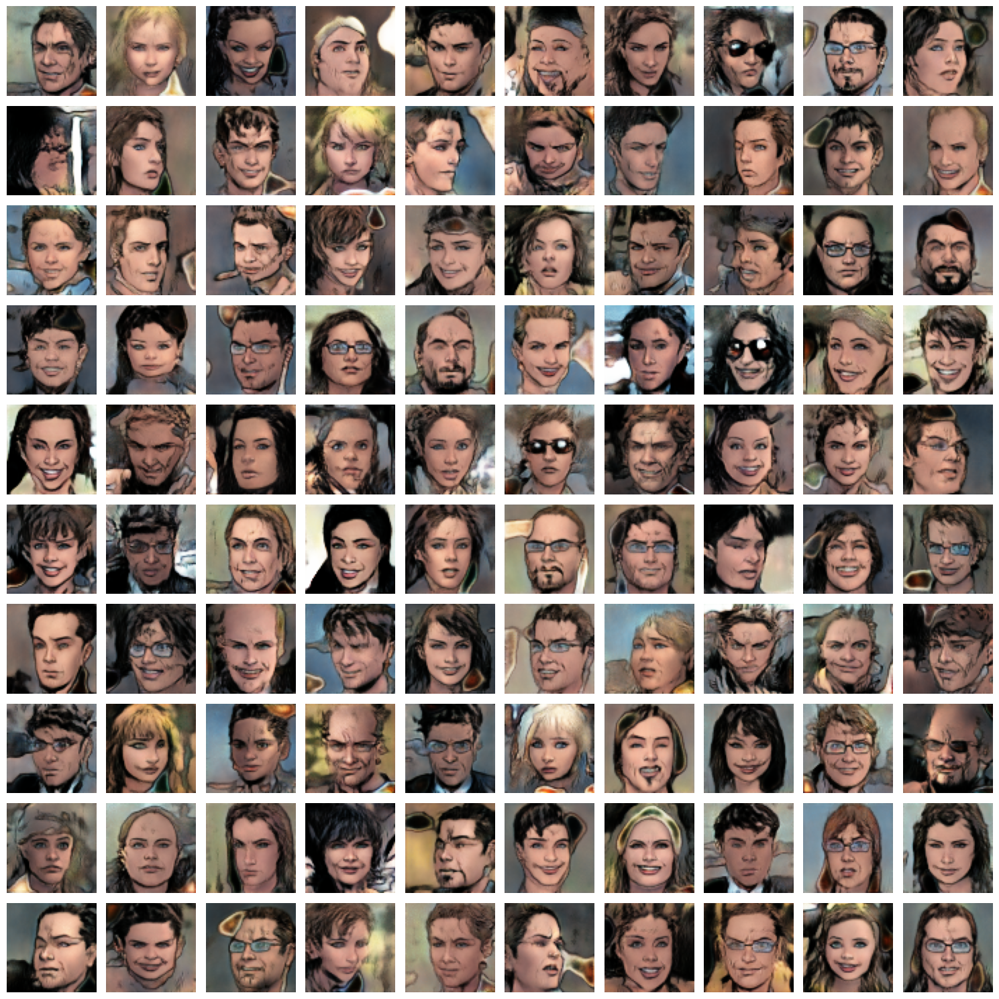

FID score at step 4: 26.102008819580078
Curent image size: 128
Epoch [1/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.12, loss_critic=-4.35]  


Epoch [2/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.102, loss_critic=-9.32] 


Epoch [3/ 45


100%|██████████| 625/625 [03:31<00:00,  2.96it/s, gp=0.257, loss_critic=-6.92] 


Epoch [4/ 45


100%|██████████| 625/625 [03:31<00:00,  2.96it/s, gp=0.109, loss_critic=-12.9] 


Epoch [5/ 45


100%|██████████| 625/625 [03:31<00:00,  2.96it/s, gp=0.144, loss_critic=-8.71] 


Epoch [6/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.173, loss_critic=-8.35] 


Epoch [7/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.12, loss_critic=-14.2]  


Epoch [8/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.069, loss_critic=-14.5] 


Epoch [9/ 45


100%|██████████| 625/625 [03:32<00:00,  2.94it/s, gp=0.126, loss_critic=-5.77] 


Epoch [10/ 45


100%|██████████| 625/625 [03:31<00:00,  2.96it/s, gp=0.103, loss_critic=-15.6] 


Epoch [11/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.129, loss_critic=-8.04] 


Epoch [12/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.0986, loss_critic=-6.79]


Epoch [13/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.119, loss_critic=-2.99] 


Epoch [14/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.0553, loss_critic=-7.45]


Epoch [15/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.261, loss_critic=-11.3] 


Epoch [16/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.103, loss_critic=-4.82] 


Epoch [17/ 45


100%|██████████| 625/625 [03:32<00:00,  2.94it/s, gp=0.087, loss_critic=-3.46] 


Epoch [18/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.108, loss_critic=-6.98] 


Epoch [19/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.146, loss_critic=-6.46] 


Epoch [20/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.1, loss_critic=-10.7]   


Epoch [21/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.121, loss_critic=-4.38] 


Epoch [22/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.229, loss_critic=-10.8] 


Epoch [23/ 45


100%|██████████| 625/625 [03:31<00:00,  2.96it/s, gp=0.062, loss_critic=-6.15] 


Epoch [24/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.0943, loss_critic=-4.24]


Epoch [25/ 45


100%|██████████| 625/625 [03:32<00:00,  2.95it/s, gp=0.142, loss_critic=-3.42] 


Epoch [26/ 45


100%|██████████| 625/625 [03:32<00:00,  2.94it/s, gp=0.0913, loss_critic=-2.23]


Epoch [27/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.106, loss_critic=-4]    


Epoch [28/ 45


100%|██████████| 625/625 [03:31<00:00,  2.96it/s, gp=0.104, loss_critic=-6.6]  


Epoch [29/ 45


100%|██████████| 625/625 [03:31<00:00,  2.96it/s, gp=0.118, loss_critic=-12]   


Epoch [30/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.0598, loss_critic=1.04] 


Epoch [31/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.0865, loss_critic=-7.1] 


Epoch [32/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.125, loss_critic=-10.1] 


Epoch [33/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.0673, loss_critic=-10]   


Epoch [34/ 45


100%|██████████| 625/625 [03:32<00:00,  2.94it/s, gp=0.162, loss_critic=-3.96] 


Epoch [35/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.0875, loss_critic=-9.61]


Epoch [36/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.109, loss_critic=-2.28] 


Epoch [37/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.0834, loss_critic=-.227]


Epoch [38/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.0561, loss_critic=-5.05]


Epoch [39/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.055, loss_critic=-2.08] 


Epoch [40/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.108, loss_critic=-4.23] 


Epoch [41/ 45


100%|██████████| 625/625 [03:32<00:00,  2.94it/s, gp=0.0509, loss_critic=-5.87]


Epoch [42/ 45


100%|██████████| 625/625 [03:32<00:00,  2.95it/s, gp=0.213, loss_critic=-3.02] 


Epoch [43/ 45


100%|██████████| 625/625 [03:32<00:00,  2.94it/s, gp=0.105, loss_critic=-5.34] 


Epoch [44/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.054, loss_critic=-6.65] 


Epoch [45/ 45


100%|██████████| 625/625 [03:31<00:00,  2.95it/s, gp=0.123, loss_critic=-10.7] 


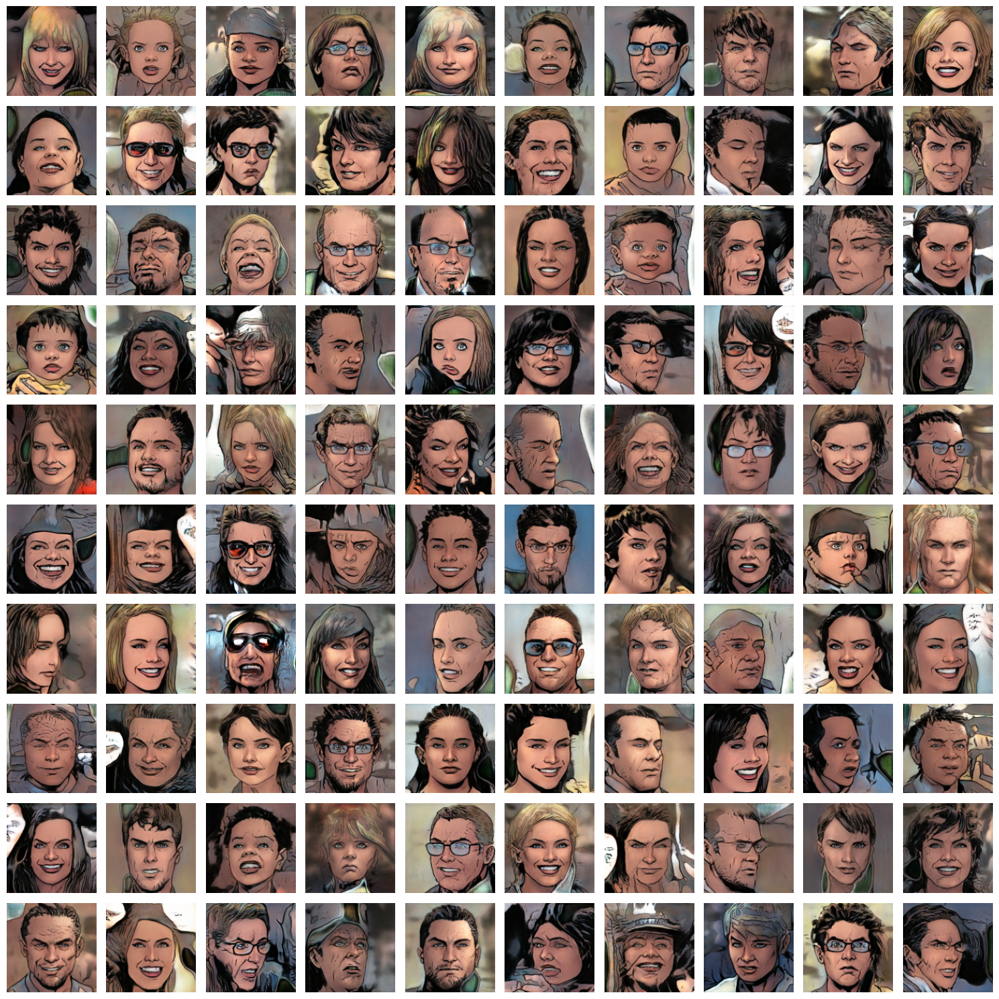

FID score at step 5: 16.469104766845703
FID scores saved to fid_metrics_scores_45.csv.


In [33]:
# training

gen = Generator(
    Z_DIM, W_DIM, IN_CHANNELS, CHANNELS_IMG
).to(DEVICE)
critic = Discriminator(IN_CHANNELS, CHANNELS_IMG).to(DEVICE)
opt_gen = optim.Adam([{'params': [param for name, param in gen.named_parameters() if 'map' not in name]},
                     {'params': gen.map.parameters(), 'lr': 1e-5}], lr=LR, betas =(0.0, 0.99))
opt_critic = optim.Adam(
    critic.parameters(), lr= LR, betas =(0.0, 0.99)
)
gen.train()
critic.train()
step = int(log2(INITIAL_IMG_SIZE / 4))

csv_file_path = "fid_metrics_scores_45.csv"
header = ["Step", "FID Score"]

with open(csv_file_path, mode="w", newline="") as file:
   writer = csv.writer(file)
   writer.writerow(header)

for num_epochs in PROGRESSIVE_EPOCHS[step:]:
    alpha = 1e-7
    loader, dataset = get_loader(4*2**step)
    print('Curent image size: '+str(4*2**step))

    for epoch in range(num_epochs):
        print(f'Epoch [{epoch + 1}/ {num_epochs}')
        alpha = train_fn(
            critic, gen, loader, dataset, step, alpha, opt_critic, opt_gen
        )
    generate_examples(gen, step)
    
    fid_score = compute_fid_score(gen, loader, step)
    print(f"FID score at step {step}: {fid_score}")
    with open("fid_scores_45.txt", "a") as f:
       f.write(f"Step {step}: FID = {fid_score}\n")
    
    # Append to CSV file
    with open(csv_file_path, mode="a", newline="") as file:
       writer = csv.writer(file)
       writer.writerow([step, fid_score])

    step +=1
print(f"FID scores saved to {csv_file_path}.")


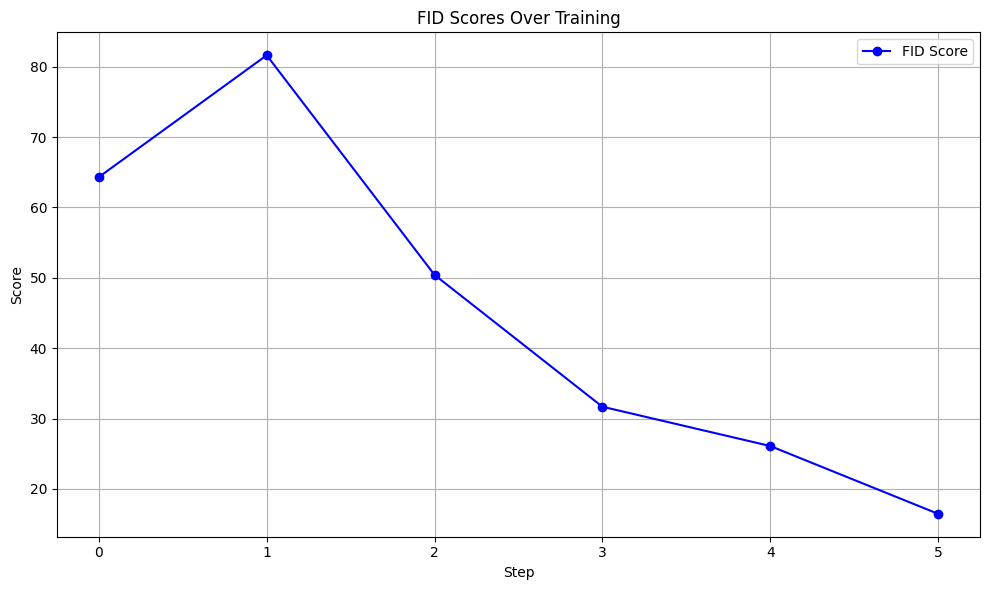

In [36]:
# Plot FID scores over the course of training
import matplotlib.pyplot as plt
import pandas as pd

# Load the CSV file
data = pd.read_csv("fid_metrics_scores_45.csv")
plt.figure(figsize=(10, 6))
plt.plot(data['Step'], data['FID Score'], label='FID Score', color='b', linestyle='-', marker='o')
plt.xlabel('Step')
plt.ylabel('Score')
plt.title('FID Scores Over Training')
plt.legend()
plt.grid(True)
plt.tight_layout()

# Save the plot
plt.savefig("metrics_plot_45.png")
plt.show()


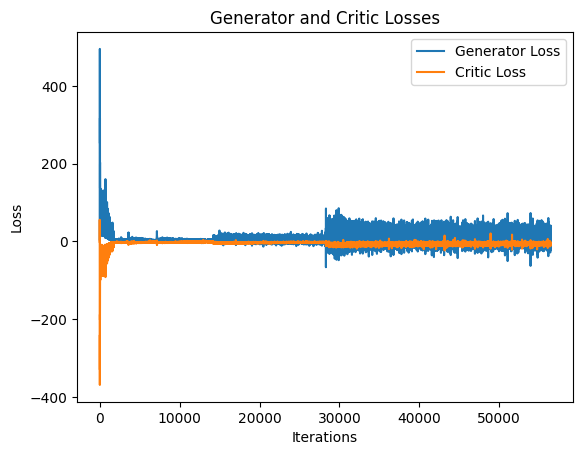

In [41]:
# Plot the losses
plt.figure()
plt.plot(loss_gen_list_45, label="Generator Loss")
plt.plot(loss_critic_list_45, label="Critic Loss")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.title("Generator and Critic Losses")
plt.legend()
plt.savefig("loss_plot_45.png")
plt.show()



In [39]:
# save models
save_dir = "saved_models_45"
os.makedirs(save_dir, exist_ok=True)

generator_path = os.path.join(save_dir, 'generator_45.pth')
discriminator_path = os.path.join(save_dir, 'discriminator_45.pth')
optimizer_gen_path = os.path.join(save_dir, 'optimizer_gen_45.pth')
optimizer_critic_path = os.path.join(save_dir, 'optimizer_critic_45.pth')
step_path = os.path.join(save_dir, 'training_step_45.pth')

torch.save(gen.state_dict(), generator_path)
torch.save(critic.state_dict(), discriminator_path)
torch.save(opt_gen.state_dict(), optimizer_gen_path)
torch.save(opt_critic.state_dict(), optimizer_critic_path)

torch.save(step, step_path)

print("Model, optimizers, and steps saved!")

config = {
    "Z_DIM": Z_DIM,
    "W_DIM": W_DIM,
    "IN_CHANNELS": IN_CHANNELS,
    "CHANNELS_IMG": CHANNELS_IMG,
    "LR": LR,
    "BATCH_SIZE": BATCH_SIZES,
    "PROGRESSIVE_EPOCHS": PROGRESSIVE_EPOCHS,
    "INITIAL_IMG_SIZE": INITIAL_IMG_SIZE,
    "DEVICE": DEVICE,
}

config_path = os.path.join(save_dir, 'config_45.pth')
torch.save(config, config_path)

print("Configuration saved!")


Model, optimizers, and steps saved!
Configuration saved!


In [40]:
# Compute PPL from the saved models and configurations
save_dir = "saved_models_45"
config_path = os.path.join(save_dir, 'config_45.pth')
config = torch.load(config_path)
DEVICE = config["DEVICE"]
Z_DIM = config["Z_DIM"]
W_DIM = config["W_DIM"]
IN_CHANNELS = config["IN_CHANNELS"]
CHANNELS_IMG = config["CHANNELS_IMG"]

generator_path = os.path.join(save_dir, 'generator_45.pth')

gen = Generator(
    z_dim=Z_DIM,
    w_dim=W_DIM,
    in_channels=IN_CHANNELS,
    img_channels=CHANNELS_IMG
).to(DEVICE)
gen.load_state_dict(torch.load(generator_path))
gen.eval()  

step_path = os.path.join(save_dir, 'training_step_45.pth')
step = torch.load(step_path)

ppl_score = compute_ppl(gen, step, num_samples=10000, eps=1e-4, batch_size=10)
print(f"PPL Score: {ppl_score}")


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


Computing PPL: 100%|██████████| 1000/1000 [00:42<00:00, 23.43it/s]

PPL Score: 33886718.75


In [53]:
# Compute PPL from the saved models and configurations
save_dir = "saved_models_45"
config_path = os.path.join(save_dir, 'config_45.pth')
config = torch.load(config_path)
DEVICE = config["DEVICE"]
Z_DIM = config["Z_DIM"]
W_DIM = config["W_DIM"]
IN_CHANNELS = config["IN_CHANNELS"]
CHANNELS_IMG = config["CHANNELS_IMG"]

generator_path = os.path.join(save_dir, 'generator_45.pth')

gen = Generator(
    z_dim=Z_DIM,
    w_dim=W_DIM,
    in_channels=IN_CHANNELS,
    img_channels=CHANNELS_IMG
).to(DEVICE)
gen.load_state_dict(torch.load(generator_path))
gen.eval()  

step_path = os.path.join(save_dir, 'training_step_45.pth')
step = torch.load(step_path)

ppl_score = compute_ppl(gen, step, num_samples=10000, eps=1e-4, batch_size=128)
print(f"PPL Score: {ppl_score}")


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=VGG16_Weights.IMAGENET1K_V1`. You can also use `weights=VGG16_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


Computing PPL: 100%|██████████| 78/78 [02:45<00:00,  2.12s/it]


PPL Score: 34033203.125


In [54]:
# Compute PPL from the saved models and configurations
save_dir = "saved_models_45"
config_path = os.path.join(save_dir, 'config_45.pth')
config = torch.load(config_path)
DEVICE = config["DEVICE"]
Z_DIM = config["Z_DIM"]
W_DIM = config["W_DIM"]
IN_CHANNELS = config["IN_CHANNELS"]
CHANNELS_IMG = config["CHANNELS_IMG"]

generator_path = os.path.join(save_dir, 'generator_45.pth')

gen = Generator(
    z_dim=Z_DIM,
    w_dim=W_DIM,
    in_channels=IN_CHANNELS,
    img_channels=CHANNELS_IMG
).to(DEVICE)
gen.load_state_dict(torch.load(generator_path))
gen.eval()  

step_path = os.path.join(save_dir, 'training_step_45.pth')
step = torch.load(step_path)

ppl_score = compute_ppl(gen, step, num_samples=10000, eps=1e-4, batch_size=256)
print(f"PPL Score: {ppl_score}")


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


Computing PPL: 100%|██████████| 39/39 [09:19<00:00, 14.35s/it]


PPL Score: 33935546.875


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9607843].


Batch 1:
  Image batch shape: torch.Size([10, 3, 256, 256])
  Number of images: 10
  Image dimensions: 3 x 256


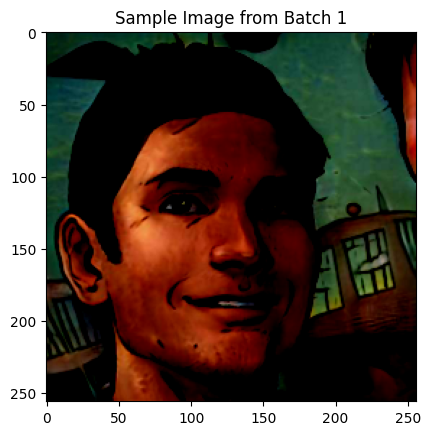

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9607843].


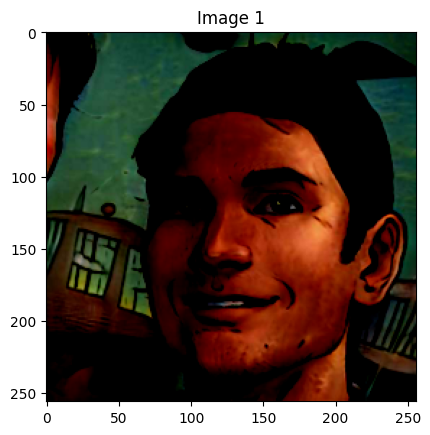

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9529412].


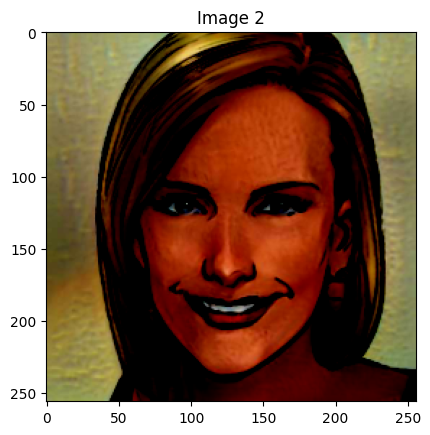

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


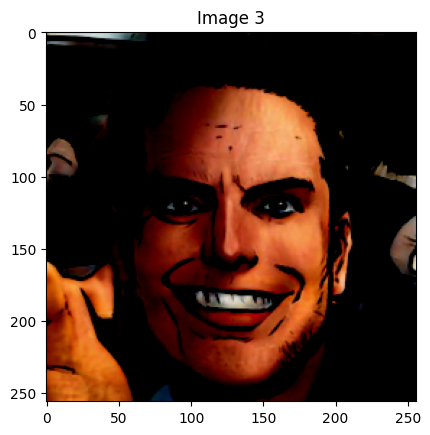

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9764706].


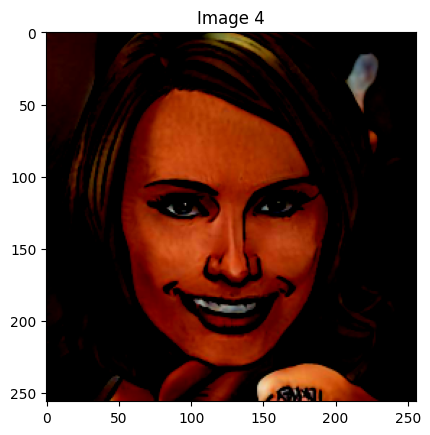

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.8980392].


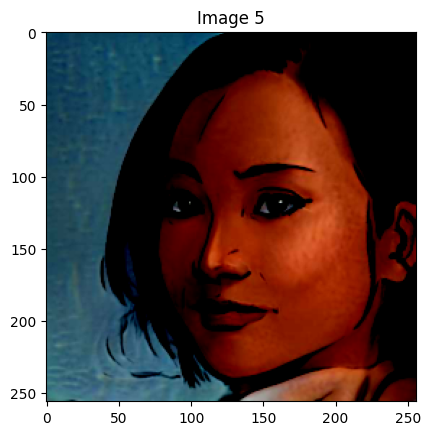

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..1.0].


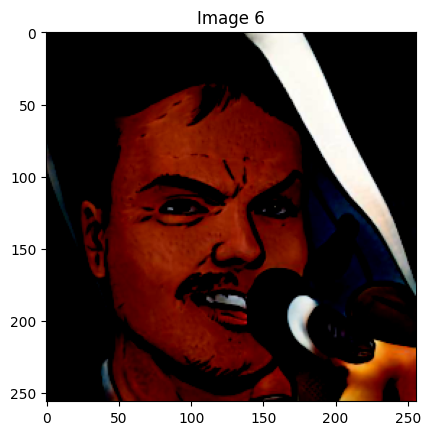

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99215686].


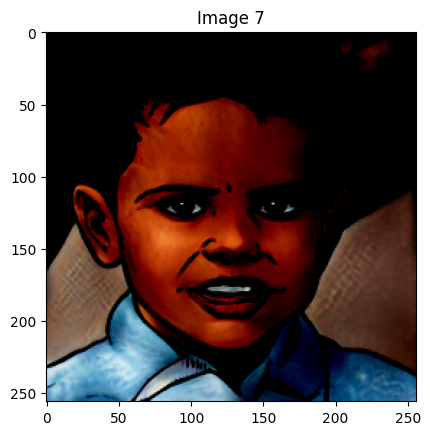

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.9607843].


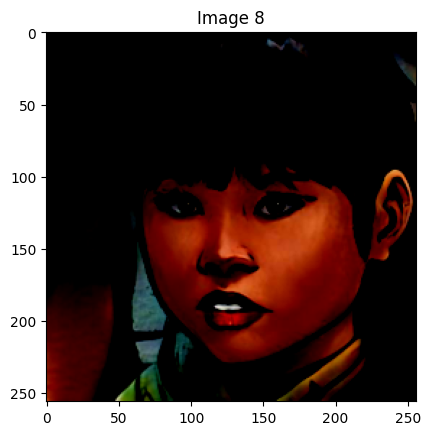

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.92156863].


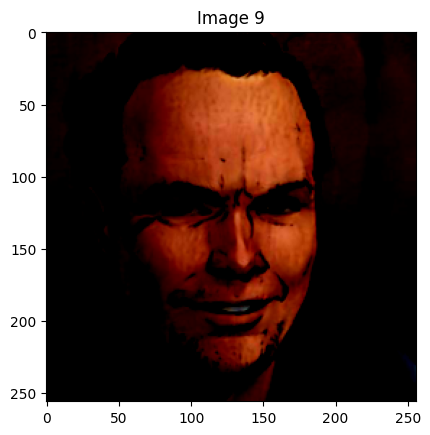

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-1.0..0.99215686].


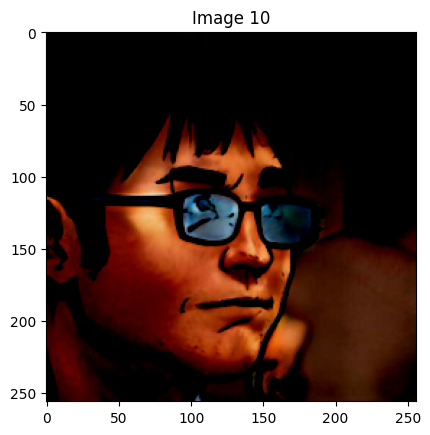

In [73]:
# Custom Dataset class to load images from test folder
class FolderDataset(Dataset):
    def __init__(self, root, transform=None):
        self.root = root
        self.transform = transform
        self.image_paths = [os.path.join(root, img) for img in os.listdir(root)
                            if img.endswith(('.png', '.jpg', '.jpeg'))]

    def __len__(self):
        return len(self.image_paths)

    def __getitem__(self, idx):
        img_path = self.image_paths[idx]
        img = Image.open(img_path).convert("RGB")
        if self.transform:
            img = self.transform(img)
        return img, 0  

def get_loader(image_size, dataset_dir):
    transform = transforms.Compose(
        [
            transforms.Resize((image_size, image_size)),
            transforms.ToTensor(),
            transforms.RandomHorizontalFlip(p=0.5),
            transforms.Normalize(
                [0.5 for _ in range(CHANNELS_IMG)],
                [0.5 for _ in range(CHANNELS_IMG)],
            ),
        ]
    )
    batch_size = 128
    dataset = FolderDataset(root=dataset_dir, transform=transform)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=False)
    return loader, dataset

def check_loader(loader, num_batches=2):
    for i, (images, labels) in enumerate(loader):
        if i >= num_batches:
            break
        print(f"Batch {i + 1}:")
        print(f"  Image batch shape: {images.shape}")
        print(f"  Number of images: {images.size(0)}")
        print(f"  Image dimensions: {images.size(1)} x {images.size(2)}")
        plt.imshow(images[0].permute(1, 2, 0).cpu().numpy())
        plt.title(f"Sample Image from Batch {i + 1}")
        plt.show()

test_loader, _ = get_loader(image_size=256, dataset_dir='Stylegan/test')
check_loader(test_loader, num_batches=2)

def print_all_images(loader):
    for i, (images, _) in enumerate(loader):
        for j in range(images.size(0)):
            img = images[j].permute(1, 2, 0).cpu().numpy() 
            plt.imshow(img)
            plt.title(f"Image {i * loader.batch_size + j + 1}") 
            plt.show()

test_loader, _ = get_loader(image_size=256, dataset_dir='Stylegan/test')
print_all_images(test_loader)

In [65]:
# Calculate the FID score using the test dataset from saved models

save_dir = "saved_models_45"
config_path = os.path.join(save_dir, 'config_45.pth')
config = torch.load(config_path)
DEVICE = config["DEVICE"]
Z_DIM = config["Z_DIM"]
W_DIM = config["W_DIM"]
IN_CHANNELS = config["IN_CHANNELS"]
CHANNELS_IMG = config["CHANNELS_IMG"]

generator_path = os.path.join(save_dir, 'generator_45.pth')
gen = Generator(
    z_dim=Z_DIM,
    w_dim=W_DIM,
    in_channels=IN_CHANNELS,
    img_channels=CHANNELS_IMG
).to(DEVICE)
gen.load_state_dict(torch.load(generator_path))
gen.eval()

step_path = os.path.join(save_dir, 'training_step_45.pth')
step = torch.load(step_path)

dataset_dir = 'Stylegan/test'
test_loader, _ = get_loader(image_size=256, dataset_dir=dataset_dir)

fid_score = compute_fid_score(gen, test_loader, step, num_images=10, batch_size=10)
print(f"FID Score: {fid_score}")

FID Score: 382.7496337890625


In [68]:
# Calculate the FID score using the test dataset from saved models

save_dir = "saved_models_45"
config_path = os.path.join(save_dir, 'config_45.pth')
config = torch.load(config_path)
DEVICE = config["DEVICE"]
Z_DIM = config["Z_DIM"]
W_DIM = config["W_DIM"]
IN_CHANNELS = config["IN_CHANNELS"]
CHANNELS_IMG = config["CHANNELS_IMG"]

generator_path = os.path.join(save_dir, 'generator_45.pth')
gen = Generator(
    z_dim=Z_DIM,
    w_dim=W_DIM,
    in_channels=IN_CHANNELS,
    img_channels=CHANNELS_IMG
).to(DEVICE)
gen.load_state_dict(torch.load(generator_path))
gen.eval()

step_path = os.path.join(save_dir, 'training_step_45.pth')
step = torch.load(step_path)

dataset_dir = 'Stylegan/test'
test_loader, _ = get_loader(image_size=256, dataset_dir=dataset_dir)

fid_score = compute_fid_score(gen, test_loader, step, num_images=10, batch_size=256)
print(f"FID Score: {fid_score}")

FID Score: 407.87249755859375


In [66]:
# Calculate the FID score using the test dataset from saved models

save_dir = "saved_models_35"
config_path = os.path.join(save_dir, 'config_35.pth')
config = torch.load(config_path)
DEVICE = config["DEVICE"]
Z_DIM = config["Z_DIM"]
W_DIM = config["W_DIM"]
IN_CHANNELS = config["IN_CHANNELS"]
CHANNELS_IMG = config["CHANNELS_IMG"]

generator_path = os.path.join(save_dir, 'generator_35.pth')
gen = Generator(
    z_dim=Z_DIM,
    w_dim=W_DIM,
    in_channels=IN_CHANNELS,
    img_channels=CHANNELS_IMG
).to(DEVICE)
gen.load_state_dict(torch.load(generator_path))
gen.eval()

step_path = os.path.join(save_dir, 'training_step_35.pth')
step = torch.load(step_path)

dataset_dir = 'Stylegan/test'
test_loader, i = get_loader(image_size=256, dataset_dir=dataset_dir)

fid_score = compute_fid_score(gen, test_loader, step, num_images=10, batch_size=10)
print(f"FID Score: {fid_score}")

FID Score: 403.0787353515625


In [72]:
# Load the test dataset, models and compute PPL score. PPL doesn't use test dataset directly. It checks the generated samples from the model.
save_dir = "saved_models_35"
config_path = os.path.join(save_dir, 'config_35.pth')
config = torch.load(config_path)
DEVICE = config["DEVICE"]
Z_DIM = config["Z_DIM"]
W_DIM = config["W_DIM"]
IN_CHANNELS = config["IN_CHANNELS"]
CHANNELS_IMG = config["CHANNELS_IMG"]

generator_path = os.path.join(save_dir, 'generator_35.pth')
gen = Generator(
    z_dim=Z_DIM,
    w_dim=W_DIM,
    in_channels=IN_CHANNELS,
    img_channels=CHANNELS_IMG
).to(DEVICE)
gen.load_state_dict(torch.load(generator_path))
gen.eval()

step_path = os.path.join(save_dir, 'training_step_35.pth')
step = torch.load(step_path)

dataset_dir = 'Stylegan/test'
def get_loader(image_size, dataset_dir):
    transform = transforms.Compose(
        [
            transforms.Resize((image_size, image_size)),
            transforms.ToTensor(),
            transforms.Normalize([0.5] * 3, [0.5] * 3),
        ]
    )
    batch_size = 128
    dataset = FolderDataset(root=dataset_dir, transform=transform)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=False)
    return loader, dataset

test_loader, _ = get_loader(image_size=256, dataset_dir=dataset_dir)
ppl_score = compute_ppl(gen, step, num_samples=10, eps=1e-4, batch_size=10)
print(f"PPL Score: {ppl_score}")


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


Computing PPL: 100%|██████████| 1/1 [00:00<00:00, 15.41it/s]


PPL Score: 34472656.25


In [74]:
# Load the test dataset, models and compute PPL score. PPL doesn't use test dataset directly. It checks the generated samples from the model.
save_dir = "saved_models_45"
config_path = os.path.join(save_dir, 'config_45.pth')
config = torch.load(config_path)
DEVICE = config["DEVICE"]
Z_DIM = config["Z_DIM"]
W_DIM = config["W_DIM"]
IN_CHANNELS = config["IN_CHANNELS"]
CHANNELS_IMG = config["CHANNELS_IMG"]

generator_path = os.path.join(save_dir, 'generator_45.pth')
gen = Generator(
    z_dim=Z_DIM,
    w_dim=W_DIM,
    in_channels=IN_CHANNELS,
    img_channels=CHANNELS_IMG
).to(DEVICE)
gen.load_state_dict(torch.load(generator_path))
gen.eval()

step_path = os.path.join(save_dir, 'training_step_45.pth')
step = torch.load(step_path)

dataset_dir = 'Stylegan/test'
def get_loader(image_size, dataset_dir):
    transform = transforms.Compose(
        [
            transforms.Resize((image_size, image_size)),
            transforms.ToTensor(),
            transforms.Normalize([0.5] * 3, [0.5] * 3),
        ]
    )
    batch_size = 128
    dataset = FolderDataset(root=dataset_dir, transform=transform)
    loader = DataLoader(dataset, batch_size=batch_size, shuffle=False)
    return loader, dataset

test_loader, _ = get_loader(image_size=256, dataset_dir=dataset_dir)
ppl_score = compute_ppl(gen, step, num_samples=10, eps=1e-4, batch_size=10)
print(f"PPL Score: {ppl_score}")


Setting up [LPIPS] perceptual loss: trunk [vgg], v[0.1], spatial [off]
Loading model from: /opt/conda/lib/python3.10/site-packages/lpips/weights/v0.1/vgg.pth


Computing PPL: 100%|██████████| 1/1 [00:00<00:00, 11.46it/s]


PPL Score: 34082031.25


- We see the PPL scores are very high.
- The FID scores obtained after training for the final step, step 5 gave a very good result as compared to that on test set. This is because of better training and convergence.  